# Police Fatalities in the US From 2000 To 2020

Data obtained from Kaggle: https://www.kaggle.com/datasets/djonafegnem/police-fatalities-in-the-us-from-2000-to-2020

GitHub link: https://github.com/samantharivas/Police_Fatalities.git

## Import Libaries

In [1]:
# import appropriate packages 
import pandas as pd
import numpy as np
import seaborn as sns

import dmba
from dmba import regressionSummary, gainsChart, liftChart
from dmba import adjusted_r2_score, AIC_score, BIC_score

from sklearn.model_selection import GridSearchCV

from sklearn.metrics import confusion_matrix, accuracy_score, ConfusionMatrixDisplay, classification_report, f1_score
from sklearn.metrics import roc_auc_score, roc_curve
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.preprocessing import MultiLabelBinarizer
from sklearn.preprocessing import OneHotEncoder
from sklearn.impute import SimpleImputer

from statsmodels.stats.outliers_influence import variance_inflation_factor

from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_selection import SelectKBest, chi2, f_classif
from sklearn.linear_model import Perceptron, LogisticRegression

import scipy.stats as stats
from scipy.stats import chi2_contingency

import folium

from sklearn.naive_bayes import GaussianNB
from sklearn.preprocessing import MultiLabelBinarizer
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn import tree 
from sklearn.tree import plot_tree 

from sklearn.inspection import permutation_importance

from sklearn.ensemble import RandomForestClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.model_selection import GridSearchCV
import scikitplot as skplt



import os

%matplotlib inline
import matplotlib.pylab as plt
import matplotlib 
import matplotlib.ticker as mticker

import warnings
warnings.filterwarnings("ignore") #supress warnings

no display found. Using non-interactive Agg backend


## Import Dataset

In [2]:
# download datset from Kaggle
police_df = pd.read_csv('police_fatalities.csv') # read csv file 

# rename columns by replacing spaces with underscores
police_df.columns = police_df.columns.str.replace(' ', '_')

# replace single quotes with an empty string in column names
police_df.columns = police_df.columns.str.replace("'", "")

In [3]:
# print 10 random samples from the dataframe 
police_df.sample(10)

,Unique_ID,Subjects_name,Subjects_age,Subjects_gender,Subjects_race,Subjects_race_with_imputations,Imputation_probability,URL_of_image_of_deceased,Date_of_injury_resulting_in_death_(month/day/year),Location_of_injury_(address),...,A_brief_description_of_the_circumstances_surrounding_the_death,"Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS",Intentional_Use_of_Force_(Developing),Link_to_news_article_or_photo_of_official_document,"Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS",Video,Date&Description,Unique_ID_formula,Unique_identifier_(redundant),Date_(Year)
6166,4918,DeAngelo Cazares Rivera,26,Male,Hispanic/Latino,Hispanic/Latino,not imputed,https://fatalencounters.org/wp-content/uploads...,02/15/2006,6200 block South Campbell Avenue,...,"Earlier the night Rivera was shot, he'd fired ...",Justified,"Intentional Use of Force, Deadly",http://tucson.com/news/local/crime/man-killed-...,Drug or alcohol use,NaN,"2/15/2006: Earlier the night Rivera was shot, ...",NaN,4918.0,2006.0
20075,16867,Michael Johnson,51,Male,European-American/White,European-American/White,not imputed,https://fatalencounters.org/wp-content/uploads...,11/06/2015,1015 NW 22nd Ave,...,Johnson was holding a gun to his head while st...,Pending investigation,"Intentional Use of Force, Deadly",http://www.oregonlive.com/portland/index.ssf/2...,Yes,NaN,11/6/2015: Johnson was holding a gun to his he...,NaN,16867.0,2015.0
25540,25387,Robert Myers,63,Male,European-American/White,European-American/White,not imputed,https://www.fatalencounters.org/wp-content/upl...,01/03/2019,65275 Middle Rd,...,Police received a call around noon for a suici...,Pending investigation,"Intentional Use of Force, Deadly",http://www.news12.com/story/39727832/officials...,Yes,NaN,1/3/2019: Police received a call around noon f...,NaN,25387.0,2019.0
12474,9889,Antonio Thomas,31,Male,Race unspecified,European-American/White,0.614649172,NaN,02/19/2011,5400 North Lincoln Avenue,...,Antonio Thomas was found unresponsive at the F...,Unreported,Undetermined,http://www.daily-chronicle.com/2011/02/19/deka...,Drug or alcohol use,NaN,2/19/2011: Antonio Thomas was found unresponsi...,NaN,9889.0,2011.0
489,359,Joseph Howard Jr.,52,Male,Race unspecified,African-American/Black,0.627955577,NaN,07/29/2000,Blue Pkwy & E State Rte 350 & E 63rd St,...,Joseph Howard Jr. was killed when his vehicle ...,Unreported,Vehicle/Pursuit,https://drive.google.com/file/d/0B62PuBu1vKRLV...,No,NaN,7/29/2000: Joseph Howard Jr. was killed when h...,NaN,359.0,2000.0
3747,3002,John Franklin McCoy,23,Male,European-American/White,European-American/White,not imputed,NaN,12/09/2003,corner of 15th Street/Prater Way,...,Sparks officers were attempting to arrest McCo...,Unknown,"Intentional Use of Force, Deadly",https://drive.google.com/file/d/0B-l9Ys3cd80fL...,No,NaN,12/9/2003: Sparks officers were attempting to ...,NaN,3002.0,2003.0
5564,21748,Ibn Berger,22,Male,African-American/Black,African-American/Black,not imputed,NaN,08/07/2005,126 Seth Boyden Terrace,...,Two officers responded to reports of gunfire a...,Unreported,"Intentional Use of Force, Deadly",http://www.nytimes.com/2005/08/09/nyregion/09s...,Unknown,NaN,8/7/2005: Two officers responded to reports of...,NaN,21748.0,2005.0
328,20801,Keith Driskel Jr.,22,Male,European-American/White,European-American/White,not imputed,NaN,05/16/2000,Dutch Settlement Road,...,Police responded to a disturbance at the home ...,Suicide,Suicide,http://www.heraldpalladium.com/localnews/cass-...,No,NaN,5/16/2000: Police responded to a disturbance a...,NaN,20801.0,2000.0
22772,20752,Emily Fatzinger,25,Female,European-American/White,European-American/White,not imputed,https://www.fatalencounters.org/wp-content/upl...,06/24/2017,5000 block Limeport Rd,...,Emily Fatzinger and Eric Messick were found de...,Murder/suicide,"Intentional Use of Force, Deadly",http://www.lehighvalleylive.com/lehigh-county/...,No,NaN,6/24/2017: Emily Fatzinger and Eric Messick we...,NaN,20752.0,2017.0
22356,1963

## Data Inspection

In [4]:
police_df.shape

(28335, 29)

In [5]:
police_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28335 entries, 0 to 28334
Data columns (total 29 columns):
 #   Column                                                          Non-Null Count  Dtype  
---  ------                                                          --------------  -----  
 0   Unique_ID                                                       28334 non-null  object 
 1   Subjects_name                                                   28335 non-null  object 
 2   Subjects_age                                                    27354 non-null  object 
 3   Subjects_gender                                                 28237 non-null  object 
 4   Subjects_race                                                   28334 non-null  object 
 5   Subjects_race_with_imputations                                  27905 non-null  object 
 6   Imputation_probability                                          27897 non-null  object 
 7   URL_of_image_of_deceased                         

In [6]:
# convert columns which contain numerical values into numeric data type 

columns_to_convert = ['Subjects_age', 'Latitude', 'Longitude','Location_of_death_(zip_code)', 
                      'Imputation_probability','Unique_identifier_(redundant)', 'Date_(Year)']

for col in columns_to_convert:
    police_df[col] = pd.to_numeric(police_df[col], errors='coerce')
    
police_df.info() #check data type after conversion 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28335 entries, 0 to 28334
Data columns (total 29 columns):
 #   Column                                                          Non-Null Count  Dtype  
---  ------                                                          --------------  -----  
 0   Unique_ID                                                       28334 non-null  object 
 1   Subjects_name                                                   28335 non-null  object 
 2   Subjects_age                                                    27294 non-null  float64
 3   Subjects_gender                                                 28237 non-null  object 
 4   Subjects_race                                                   28334 non-null  object 
 5   Subjects_race_with_imputations                                  27905 non-null  object 
 6   Imputation_probability                                          7029 non-null   float64
 7   URL_of_image_of_deceased                         

In [7]:
# convert the date column to a datetime format
police_df['Date_of_injury_resulting_in_death'] = pd.to_datetime(police_df['Date_of_injury_resulting_in_death_(month/day/year)'])

# extract month, day, and year into separate columns
police_df['Injury_Month'] = police_df['Date_of_injury_resulting_in_death'].dt.month
police_df['Injury_Day'] = police_df['Date_of_injury_resulting_in_death'].dt.day
police_df['Injury_Year'] = police_df['Date_of_injury_resulting_in_death'].dt.year

police_df.sample(10)

,Unique_ID,Subjects_name,Subjects_age,Subjects_gender,Subjects_race,Subjects_race_with_imputations,Imputation_probability,URL_of_image_of_deceased,Date_of_injury_resulting_in_death_(month/day/year),Location_of_injury_(address),...,"Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS",Video,Date&Description,Unique_ID_formula,Unique_identifier_(redundant),Date_(Year),Date_of_injury_resulting_in_death,Injury_Month,Injury_Day,Injury_Year
13692,10898,Robert Evan La Rue,48.0,Male,European-American/White,European-American/White,NaN,NaN,12/27/2011,29303 Golden Meadow Drive,...,Unknown,NaN,12/27/2011: Deputies reported that they respon...,NaN,10898.0,2011.0,2011-12-27,12,27,2011
7392,5863,"Lawrence Albert ""Larry"" Wirth",22.0,Male,European-American/White,European-American/White,NaN,http://www.rennerfh.com/images/archive/Lawrenc...,01/29/2007,305 Beveridge St.,...,Unknown,NaN,1/29/2007: Officer John Doogan shot Lawrence A...,NaN,5863.0,2007.0,2007-01-29,1,29,2007
7102,19674,Donnie R. Garrett,57.0,Male,Race unspecified,European-American/White,0.924872,NaN,11/12/2006,East Main Street,...,No,NaN,11/12/2006: Police were searching for Donnie G...,NaN,19674.0,2006.0,2006-11-12,11,12,2006
1416,1110,Andrea Nicole Reedy,32.0,Female,African-American/Black,African-American/Black,NaN,NaN,07/27/2001,Eaton Street and East Pembroke Avenue,...,No,NaN,7/27/2001: Reedy was the subject of an early-m...,NaN,1110.0,2001.0,2001-07-27,7,27,2001
14931,11946,Gregory Anter Rold,37.0,Male,African-American/Black,African-American/Black,NaN,http://1.bp.blogspot.com/_DmtdGP6kzMQ/ShoI7ZQ3...,10/23/2012,1200 block Royvonne Avenue Southeast,...,No,NaN,10/23/2012: Officers were called to an apartme...,NaN,11946.0,2012.0,2012-10-23,10,23,2012
19424,16263,James Monroe Barrett,60.0,Male,European-American/White,European-American/White,NaN,http://wbtv.images.worldnow.com/images/8129910...,06/22/2015,775 North Ridge Road,...,No,NaN,6/22/2015: Deputies went to a call about a dom...,NaN,16263.0,2015.0,2015-06-22,6,22,2015
25504,25359,Mark Nicholas Farrell,33.0,Male,Race unspecified,European-American/White,0.923380,NaN,12/29/2018,44800 block Council Butte Dr,...,Yes,NaN,12/29/2018: Deputies responded to an assault i...,NaN,25359.0,2018.0,2018-12-29,12,29,2018
24044,23922,Robert Gooden,35.0,Male,Race unspecified,African-American/Black,0.805942,NaN,03/13/2018,2600 block Park Edge Drive,...,No,NaN,3/13/2018: Robert Gooden took 14-year-old girl...,NaN,23922.0,2018.0,2018-03-13,3,13,2018
5777,4612,Felix Dehoyas,26.0,Male,Race unspecified,Race unspecified,NaN,NaN,10/16/2005,905 East Scott Street,...,No,NaN,"10/16/2005: According to GPD, Officer Gary Bro...",NaN,4612.0,2005.0,2005-10-16,10,16,2005
17810,14702,De'Audry Carr,43.0,Male,African-American/Black,African-American/Black,NaN,http://d1t3gia0in9tdj.cloudfront.net/photo/tri...,06/25/2014,Fifth Street and I-80,...,No,NaN,6/25/2014: De'Audry Carr and a second unnamed ...,NaN,14702.0,2014.0,2014-06-25,6,25,2014


In [8]:
police_df.columns #column names within the df 

Index(['Unique_ID', 'Subjects_name', 'Subjects_age', 'Subjects_gender',
       'Subjects_race', 'Subjects_race_with_imputations',
       'Imputation_probability', 'URL_of_image_of_deceased',
       'Date_of_injury_resulting_in_death_(month/day/year)',
       'Location_of_injury_(address)', 'Location_of_death_(city)',
       'Location_of_death_(state)', 'Location_of_death_(zip_code)',
       'Location_of_death_(county)', 'Full_Address', 'Latitude', 'Longitude',
       'Agency_responsible_for_death', 'Cause_of_death',
       'A_brief_description_of_the_circumstances_surrounding_the_death',
       'Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS',
       'Intentional_Use_of_Force_(Developing)',
       'Link_to_news_article_or_photo_of_official_document',
       'Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS', 'Video',
       'Date&Description', 'Unique_ID_formula',
       'Unique_identifier_(redundant)', 'Date_(Year)',
       'Date_of_injury_resulting_in_death', 'Injur

In [9]:
police_df.nunique() #number of unique values within each column 

Unique_ID                                                         28334
Subjects_name                                                     26982
Subjects_age                                                         97
Subjects_gender                                                       3
Subjects_race                                                         8
Subjects_race_with_imputations                                        9
Imputation_probability                                             6954
URL_of_image_of_deceased                                          12857
Date_of_injury_resulting_in_death_(month/day/year)                 7182
Location_of_injury_(address)                                      26026
Location_of_death_(city)                                           5940
Location_of_death_(state)                                            51
Location_of_death_(zip_code)                                      10460
Location_of_death_(county)                                      

In [10]:
police_df.kurtosis() # shape of distribution of numeric columns 

Subjects_age                     0.528233
Imputation_probability           0.079034
Location_of_death_(zip_code)    -1.272116
Latitude                         1.737740
Longitude                       -0.157605
Unique_ID_formula                     NaN
Unique_identifier_(redundant)   -1.200000
Date_(Year)                      0.842675
Injury_Month                    -1.167422
Injury_Day                      -1.192541
Injury_Year                      0.836232
dtype: float64

## Exploratory Data Analysis

### Handling Missing Data 

In [11]:
#identify missing values in each column 
police_df.isnull().sum()  

Unique_ID                                                             1
Subjects_name                                                         0
Subjects_age                                                       1041
Subjects_gender                                                      98
Subjects_race                                                         1
Subjects_race_with_imputations                                      430
Imputation_probability                                            21306
URL_of_image_of_deceased                                          15424
Date_of_injury_resulting_in_death_(month/day/year)                    0
Location_of_injury_(address)                                        542
Location_of_death_(city)                                             36
Location_of_death_(state)                                             1
Location_of_death_(zip_code)                                        190
Location_of_death_(county)                                      

In [12]:
# calculate missing values as a percentage of total data 
missing_percentage = (police_df.isnull().sum() / len(police_df)) * 100
missing_percentage = missing_percentage.sort_values(ascending=False)

print('Missing Value Percentage per Column:')
print(missing_percentage)

Missing Value Percentage per Column:
Unique_ID_formula                                                 99.992942
Video                                                             99.989412
Imputation_probability                                            75.193224
URL_of_image_of_deceased                                          54.434445
Subjects_age                                                       3.673902
Location_of_injury_(address)                                       1.912829
Subjects_race_with_imputations                                     1.517558
Location_of_death_(zip_code)                                       0.670549
Subjects_gender                                                    0.345862
Agency_responsible_for_death                                       0.243515
Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS         0.218811
Location_of_death_(city)                                           0.127051
Date&Description                                   

Columns with a significant portion of missing data (50% or more of their rows) will be dropped rather than imputed. This decision is made to ensure the integrity and reliability of the dataset.

In [13]:
# drop columns where more than 50% of the data is missing 

# identify columns with more than 50% missing values
columns = missing_percentage[missing_percentage > 50]
columns_to_drop = missing_percentage[missing_percentage > 50].index

print('Columns with More than 50% Missing Values:')
print(columns)

Columns with More than 50% Missing Values:
Unique_ID_formula           99.992942
Video                       99.989412
Imputation_probability      75.193224
URL_of_image_of_deceased    54.434445
dtype: float64


In [14]:
# drop the identified columns from the DataFrame
police_df.drop(columns=columns_to_drop, inplace=True)

Remaining of the missing values will be filled with the 'most frequent' value using a SimpleImputer.

In [15]:
# use SimpleImputer to replace the NaN values with the 'most frequent value '
imp = SimpleImputer(strategy = 'most_frequent')

In [16]:
# fit and transform the data replacing the NaN values of each feature with the
# 'most frequent' value of each feature
imputed_df = imp.fit_transform(police_df)

In [17]:
# obtain column names from original df
column_names = police_df.columns

# create a df from the imputed_data array
imputed_df = pd.DataFrame(imputed_df, columns=column_names)

imputed_df.head()

,Unique_ID,Subjects_name,Subjects_age,Subjects_gender,Subjects_race,Subjects_race_with_imputations,Date_of_injury_resulting_in_death_(month/day/year),Location_of_injury_(address),Location_of_death_(city),Location_of_death_(state),...,Intentional_Use_of_Force_(Developing),Link_to_news_article_or_photo_of_official_document,"Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS",Date&Description,Unique_identifier_(redundant),Date_(Year),Date_of_injury_resulting_in_death,Injury_Month,Injury_Day,Injury_Year
0,25746,Samuel H. Knapp,17.0,Male,European-American/White,European-American/White,01/01/2000,27898-27804 US-101,Willits,CA,...,Vehicle/Pursuit,https://drive.google.com/file/d/10DisrV8K5ReP1...,No,1/1/2000: Samuel Knapp was allegedly driving a...,25746.0,2000.0,2000-01-01,1,1,2000
1,25747,Mark A. Horton,21.0,Male,African-American/Black,African-American/Black,01/01/2000,Davison Freeway,Detroit,MI,...,Vehicle/Pursuit,https://drive.google.com/file/d/1-nK-RohgiM-tZ...,No,1/1/2000: Two Detroit men killed when their ca...,25747.0,2000.0,2000-01-01,1,1,2000
2,25748,Phillip A. Blurbridge,19.0,Male,African-American/Black,African-American/Black,01/01/2000,Davison Freeway,Detroit,MI,...,Vehicle/Pursuit,https://drive.google.com/file/d/1-nK-RohgiM-tZ...,No,1/1/2000: Two Detroit men killed when their ca...,25748.0,2000.0,2000-01-01,1,1,2000
3,25749,Mark Ortiz,23.0,Male,Hispanic/Latino,Hispanic/Latino,01/01/2000,600 W Cherry Ln,Carlsbad,NM,...,Vehicle/Pursuit,https://drive.google.com/file/d/1qAEefRjX_aTtC...,No,1/1/2000: A motorcycle was allegedly being dri...,25749.0,2000.0,2000-01-01,1,1,2000
4,2,Lester Miller,53.0,Male,Race unspecified,African-American/Black,01/02/2000,4850 Flakes Mill Road,Ellenwood,GA,...,"Intentional Use of Force, Deadly",https://docs.google.com/document/d/1-YuShSarW_...,No,"1/2/2000: Darren Mayfield, a DeKalb County she...",2.0,2000.0,2000-01-02,1,2,2000


### Removing Duplicate Values

In [18]:
# identify number of duplicates in the df  
duplicates = imputed_df.duplicated()

# display rows with duplicates
duplicates = imputed_df.duplicated()
count_duplicates = duplicates.sum()
print("Count of Duplicate Rows:", count_duplicates)

Count of Duplicate Rows: 0


Data frame has zero duplicate values, thus all values remain. 

### Dropping Columns 

In [19]:
# drop redudant columns that will not be used for modeling 

imputed_df.drop(columns=['Unique_identifier_(redundant)', 'Link_to_news_article_or_photo_of_official_document', 
                        'Subjects_race_with_imputations', 'Subjects_name', 'Date&Description', 
                        'Full_Address', 'Date_(Year)', 'Date_of_injury_resulting_in_death', 'Injury_Day', 
                        'Date_of_injury_resulting_in_death_(month/day/year)'],inplace=True)

imputed_df.head()

,Unique_ID,Subjects_age,Subjects_gender,Subjects_race,Location_of_injury_(address),Location_of_death_(city),Location_of_death_(state),Location_of_death_(zip_code),Location_of_death_(county),Latitude,Longitude,Agency_responsible_for_death,Cause_of_death,A_brief_description_of_the_circumstances_surrounding_the_death,"Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS",Intentional_Use_of_Force_(Developing),"Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS",Injury_Month,Injury_Year
0,25746,17.0,Male,European-American/White,27898-27804 US-101,Willits,CA,95490.0,Mendocino,39.470883,-123.361751,Mendocino County Sheriff's Office,Vehicle,Samuel Knapp was allegedly driving a stolen ve...,Unreported,Vehicle/Pursuit,No,1,2000
1,25747,21.0,Male,African-American/Black,Davison Freeway,Detroit,MI,48203.0,Wayne,42.404526,-83.092274,Los Angeles Police Department,Vehicle,Two Detroit men killed when their car crashed ...,Unreported,Vehicle/Pursuit,No,1,2000
2,25748,19.0,Male,African-American/Black,Davison Freeway,Detroit,MI,48203.0,Wayne,42.404526,-83.092274,Los Angeles Police Department,Vehicle,Two Detroit men killed when their car crashed ...,Unreported,Vehicle/Pursuit,No,1,2000
3,25749,23.0,Male,Hispanic/Latino,600 W Cherry Ln,Carlsbad,NM,88220.0,Eddy,32.45008,-104.237643,Eddy County Sheriff's Office,Vehicle,A motorcycle was allegedly being driven errati...,Unreported,Vehicle/Pursuit,No,1,2000
4,2,53.0,Male,Race unspecified,4850 Flakes Mill Road,Ellenwood,GA,30294.0,DeKalb,33.645164,-84.229413,DeKalb County Sheriff's Office,Gunshot,"Darren Mayfield, a DeKalb County sheriff's dep...",Criminal,"Intentional Use of Force, Deadly",No,1,2000


## Data Visualizations


#### Map Visualizations - Subset Dataset to California 

In [20]:
# create United States map with incidents based on longitude and latitude values - sorted by gender 

# calculate the average latitude and longitude values 
average_latitude = imputed_df['Latitude'].mean()
average_longitude = imputed_df['Longitude'].mean()

# use the average coordinates as the center
latitude_center = average_latitude
longitude_center = average_longitude


us_map = folium.Map(location=[latitude_center, longitude_center], zoom_start=3)

# add markers for each location using latitude and longitude based on identified gender 
for index, row in imputed_df.iterrows():
    gender = row["Subjects_gender"]
    color = 'blue' if gender == 'Male' else 'red' if gender == 'Female' else 'gray' 

    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=5,  
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.6,
        tooltip=f"Gender: {gender}"
    ).add_to(us_map)

# display map
us_map

All data points from the dataframe were plotted on the map. From this visualization, it is evident that there are no outliers or points outside of the United States. Since our problem focuses on police fatalities within California, we will narrow down the dataset to include only longitude and latitude points within California.

In [21]:
# create subset for California data 
ca_df = imputed_df[imputed_df['Location_of_death_(state)'] == 'CA']

# drop location by state and zip code
ca_df = ca_df.drop(columns=['Location_of_death_(state)', 'Location_of_death_(zip_code)'])

ca_df.sample(10)

,Unique_ID,Subjects_age,Subjects_gender,Subjects_race,Location_of_injury_(address),Location_of_death_(city),Location_of_death_(county),Latitude,Longitude,Agency_responsible_for_death,Cause_of_death,A_brief_description_of_the_circumstances_surrounding_the_death,"Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS",Intentional_Use_of_Force_(Developing),"Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS",Injury_Month,Injury_Year
26030,25890,55.0,Male,Asian/Pacific Islander,900 block Wilson Ave,Richmond,Contra Costa,37.945202,-122.330752,Richmond Police Department,Gunshot,"As officers arrived around 3 a.m., Luc Ciel wa...",Pending investigation,"Intentional Use of Force, Deadly",No,4,2019
23311,22778,58.0,Male,Hispanic/Latino,100 block Harding Avenue,San Fernando,Los Angeles,34.286998,-118.442869,San Fernando Police Department,Gunshot,"About 11 a.m., a caller reported hearing someo...",Pending investigation,"Intentional Use of Force, Deadly",No,10,2017
5047,4033,22.0,Male,Race unspecified,Park Moabi Rd & I-40,Needles,San Bernardino,34.717089,-114.513096,San Bernardino County Sheriff's Office,Gunshot,San Bernardino County sheriff's deputies condu...,Suicide,Suicide,Yes,3,2005
5742,4586,22.0,Male,Hispanic/Latino,1337 Cedar Ave,Long Beach,Los Angeles,33.783387,-118.195166,Long Beach Police Department,Gunshot,Officers came to Murguia's house for a parole ...,Unreported,"Intentional Use of Force, Deadly",Unknown,10,2005
3068,2457,69.0,Male,Hispanic/Latino,8100 block Electric Ave.,Stanton,Orange,33.804672,-117.990793,Orange County Sheriff's Department,Gunshot,Sgt. Joseph Balicki shot and killed unarmed Ro...,Cleared,"Intentional Use of Force, Deadly",Drug or alcohol use,4,2003
18580,15457,42.0,Male,European-American/White,6000 Hollywood Blvd,Los Angeles,Los Angeles,34.101406,-118.320844,Los Angeles Police Department,Gunshot,Officers responded to a call of an assault wit...,Unreported,"Intentional Use of Force, Deadly",No,12,2014
6863,5453,21.0,Male,African-American/Black,21St Street & Wilshire Boulevard,Santa Monica,Los Angeles,34.03212,-118.482212,Santa Monica Police Department,Gunshot,Officers responded to a fight at a nightclub. ...,Unreported,"Intentional Use of Force, Deadly",Unknown,9,2006
1867,1469,24.0,Male,Hispanic/Latino,3500 block East Olive Avenue,Fresno,Fresno,36.757726,-119.765747,Fresno Police Department,Gunshot,Officers Joe Ploharz and Ramiro Cruz shot and ...,Unknown,"Intentional Use of Force, Deadly",Unknown,2,2002
11312,8970,38.0,Female,European-American/White,3059 Cedar Ravine Road,Placerville,El Dorado,38.727905,-120.795084,Placerville Police Department,Gunshot,"Clark, a patient at Marshall Medical Center, s...",Justified,"Intentional Use of Force, Deadly",Yes,3,2010
27525,27489,41.0,Male,European-American/White,Gas Point Road and Platina Road,Igo,Shasta,40.489774,-122.550089,Shasta County Sheriff's Office,Gunshot,"Around 1:48 p.m., deputies responded to a ment...",Pending investigation,"Intentional Use of Force, Deadly",Yes,2,2020


In [22]:
# convert columns which contain numerical values into numeric data type 

columns_to_convert = ['Subjects_age', 'Latitude', 'Longitude', 'Injury_Year', 'Injury_Month']

for col in columns_to_convert:
    ca_df[col] = pd.to_numeric(ca_df[col], errors='coerce')
    
ca_df.info() #check data type after conversion 

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4549 entries, 0 to 28334
Data columns (total 17 columns):
 #   Column                                                          Non-Null Count  Dtype  
---  ------                                                          --------------  -----  
 0   Unique_ID                                                       4549 non-null   object 
 1   Subjects_age                                                    4549 non-null   float64
 2   Subjects_gender                                                 4549 non-null   object 
 3   Subjects_race                                                   4549 non-null   object 
 4   Location_of_injury_(address)                                    4549 non-null   object 
 5   Location_of_death_(city)                                        4549 non-null   object 
 6   Location_of_death_(county)                                      4549 non-null   object 
 7   Latitude                                          

In [23]:
# create a map of Califronia incidents to find outliers 

# calculate the average latitude and longitude values 
average_latitude = ca_df['Latitude'].mean()
average_longitude = ca_df['Longitude'].mean()

# use the average coordinates as the center
latitude_center = average_latitude
longitude_center = average_longitude


ca_map = folium.Map(location=[latitude_center, longitude_center], zoom_start=5)

# add markers for each location using latitude and longitude based on identified gender 
for index, row in ca_df.iterrows():
    gender = row["Subjects_gender"]
    color = 'blue' if gender == 'Male' else 'red' if gender == 'Female' else 'gray' 

    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=5,  
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.6,
        tooltip=f"Gender: {gender}"
    ).add_to(ca_map)

# display map
ca_map

The map allows us to pinpoint outliers in the longitude and latitude data. These outliers will be excluded from the dataframe as they do not align with the problem statement.

#### Pair Plot

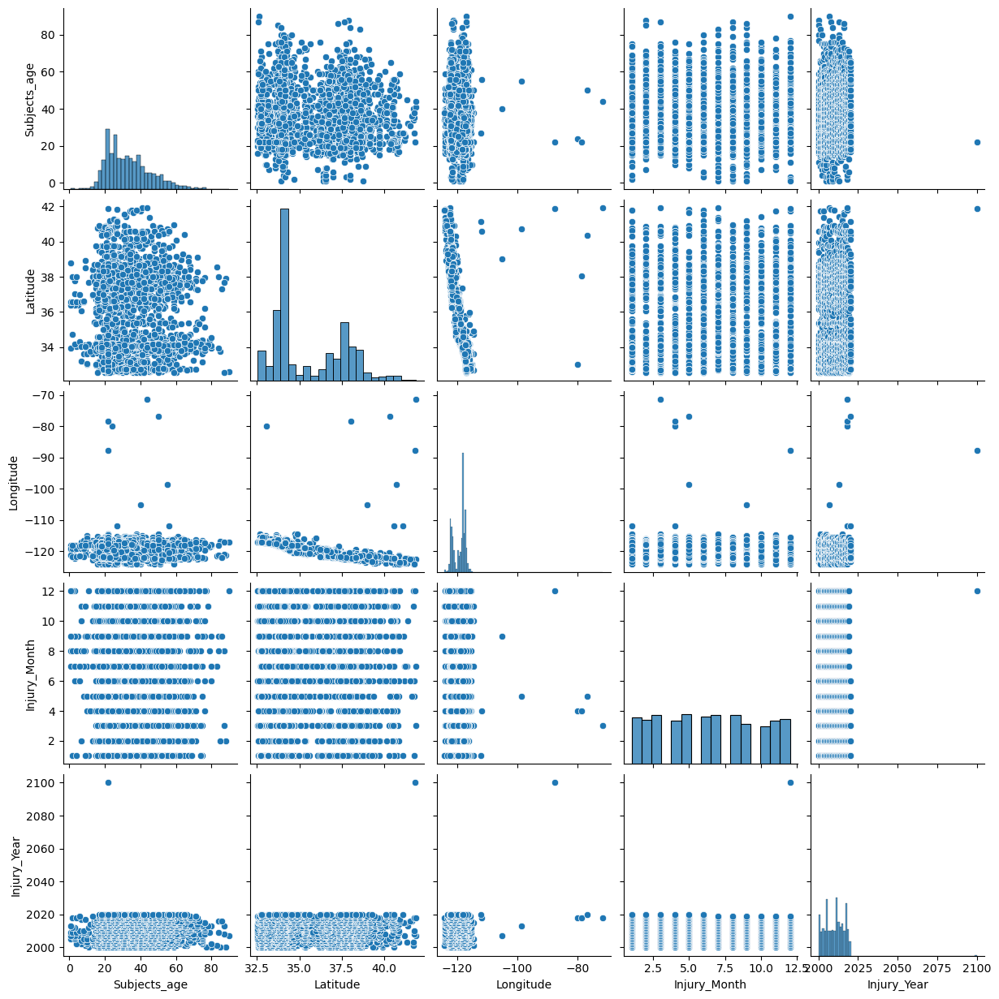

In [24]:
# reset the index to remove any duplicate labels
ca_df.reset_index(drop=True, inplace=True)

# create a pair plot
sns.pairplot(ca_df)
plt.show()

Pair plots serve as a tool for exploring the relationships between variables and identifying outliers. It is clear that there are outliers present in the following columns: Injury_Year, Subjects_age, Longitude, and Latitude. Further investigation into these outliers is warranted.

#### Box Plots

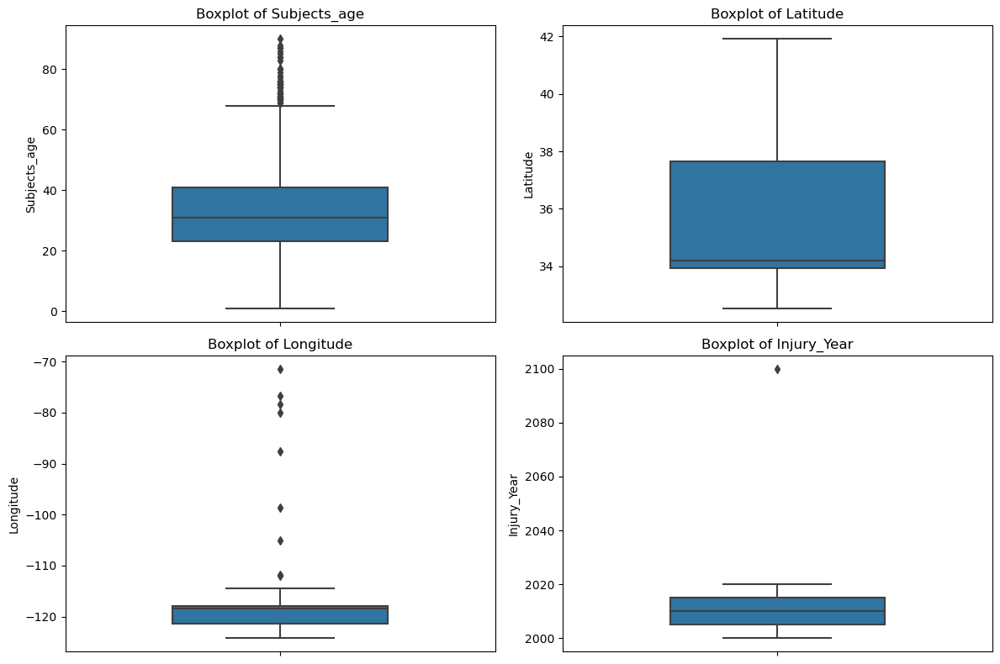

In [25]:
# List of numerical predictors
predictors = ['Subjects_age', 'Latitude', 'Longitude', 'Injury_Year']

# create boxplots 
plt.figure(figsize=(12, 8))  

for i, predictor in enumerate(predictors):
    plt.subplot(2, 2, i + 1)  
    sns.boxplot(data=ca_df, y=predictor, width=0.5)
    plt.title(f'Boxplot of {predictor}')
    plt.ylabel(predictor)

plt.tight_layout()  
plt.show()

It seems that there is an outlier in the 'Injury_Year' column, which will be adjusted to display data collected only from 2000 to 2020. The year 2100, which appears to be a placeholder, will be excluded from the dataset.

#### Bar Plots

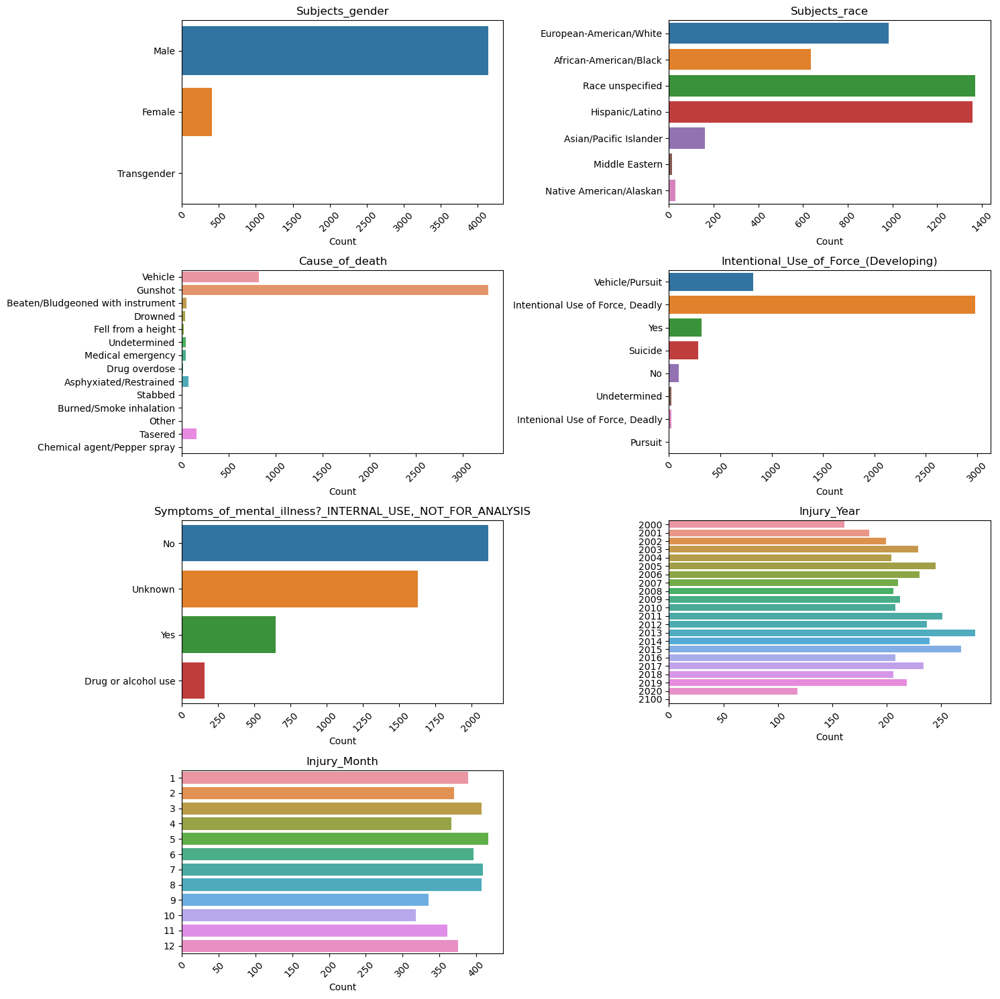

In [26]:
# list of selected columns for bar plot 
selected_columns =['Subjects_gender', 'Subjects_race', 'Cause_of_death', 'Intentional_Use_of_Force_(Developing)',
                   'Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS', 'Injury_Year', 'Injury_Month']

# calculate the number of rows and columns for the subplot grid
num_cols = 2
num_rows = (len(selected_columns) - 1) // num_cols + 1

# create subplots and flatten axis
fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 15))
axes = axes.flatten()

# iterate through selected columns and create horizontal countplots
for i, column in enumerate(selected_columns):
    sns.countplot(data=ca_df, y=column, ax=axes[i])
    axes[i].tick_params(axis='x', rotation=45)  

    axes[i].set_title(f'{column}')
    axes[i].set_xlabel('Count')
    axes[i].set_ylabel('')

# remove empty subplots
for i in range(len(selected_columns), num_rows * num_cols):
    fig.delaxes(axes[i])

plt.tight_layout()
plt.show()

The barplots reveal the following insights: a significant proportion of the individuals are male, with an undisclosed racial background, and their fatalities result from intentional gunshot injuries. When examining the data by year and month of fatalities, it becomes evident that 2013 has the highest recorded cases, while 2020 has the fewest. The distribution of injury occurrence across months appears to be fairly uniform.

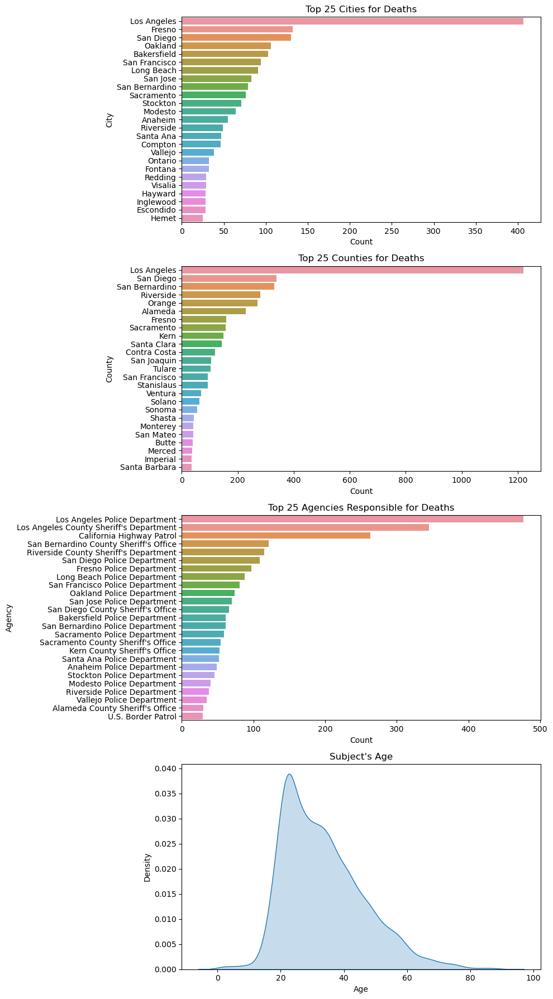

In [27]:
# create figure with subplots
fig, axes = plt.subplots(4, 1, figsize=(10, 18))

# first subplot - top 25 cities for deaths 
sns.countplot(data=ca_df, y='Location_of_death_(city)', 
              order=ca_df['Location_of_death_(city)'].value_counts().index[:25], ax=axes[0])
axes[0].set_xlabel('Count')
axes[0].set_ylabel('City')
axes[0].set_title('Top 25 Cities for Deaths')


# second subplot - top 25 counties for deaths 
sns.countplot(data=ca_df, y='Location_of_death_(county)', 
              order=ca_df['Location_of_death_(county)'].value_counts().index[:25], ax=axes[1])
axes[1].set_xlabel('Count')
axes[1].set_ylabel('County')
axes[1].set_title('Top 25 Counties for Deaths')

# third subplot - top 25 agencies responsible for deaths 
sns.countplot(data=ca_df, y='Agency_responsible_for_death', 
              order=ca_df['Agency_responsible_for_death'].value_counts().index[:25], ax=axes[2])
axes[2].set_xlabel('Count')
axes[2].set_ylabel('Agency')
axes[2].set_title('Top 25 Agencies Responsible for Deaths')


# fourth subplot - subjects age 
sns.kdeplot(data=ca_df, x='Subjects_age', fill=True, ax=axes[3])
axes[3].set_xlabel('Age')
axes[3].set_ylabel('Density')
axes[3].set_title('Subject\'s Age')


# Adjust subplot spacing
plt.tight_layout()

# Show the combined plot
plt.show()

The bar plots highlight a clear regional concentration of police fatalities in Los Angeles County, with the Los Angeles Police Department being prominently involved. They also point out that some agencies, such as the US Border Patrol and the Alameda County Sheriff's Office, are associated with fewer fatalities, suggesting variations in incident rates across different law enforcement agencies.

#### Line Plot (Trend of Deaths)

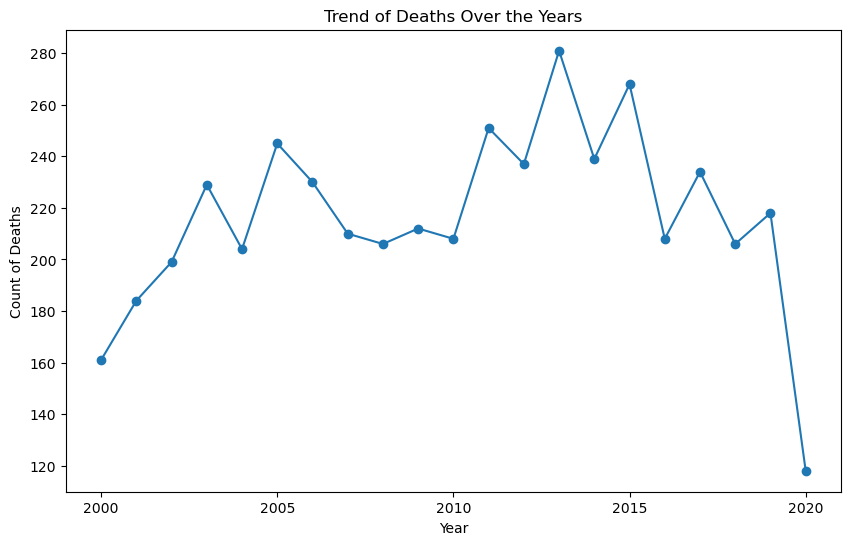

In [28]:
# per boxplot, the years will be filtered to 2000-2020 (outliers removed from 'Injury_Year')
ca_df = ca_df[(ca_df['Injury_Year'] >= 2000) & (ca_df['Injury_Year'] <= 2020)]

yearly_deaths = ca_df['Injury_Year'].value_counts().sort_index()

# create a line plot for the trend
plt.figure(figsize=(10, 6))
plt.plot(yearly_deaths.index, yearly_deaths.values, marker='o', linestyle='-')
plt.xlabel('Year')
plt.ylabel('Count of Deaths')
plt.title('Trend of Deaths Over the Years')

# set x-axis ticks to display every 5 years from 2000 to 2020
plt.xticks(range(2000, 2021, 5))


plt.grid(False)
plt.show()

### Removing Outliers 

In [29]:
# removing outliers from 'longitude' and 'latitude' 

# calculate the interquartile range (IQR) for latitude and longitude to remove outliers 
Q1_latitude = ca_df['Latitude'].quantile(0.25)
Q3_latitude = ca_df['Latitude'].quantile(0.75)
IQR_latitude = Q3_latitude - Q1_latitude

Q1_longitude = ca_df['Longitude'].quantile(0.25)
Q3_longitude = ca_df['Longitude'].quantile(0.75)
IQR_longitude = Q3_longitude - Q1_longitude

# define the lower and upper bounds using IQR
latitude_lower_bound = Q1_latitude - 1.5 * IQR_latitude
latitude_upper_bound = Q3_latitude + 1.5 * IQR_latitude

longitude_lower_bound = Q1_longitude - 1.5 * IQR_longitude
longitude_upper_bound = Q3_longitude + 1.5 * IQR_longitude

# filter df based on IQR
filtered_df = ca_df[
    (ca_df['Latitude'] >= latitude_lower_bound) &
    (ca_df['Latitude'] <= latitude_upper_bound) &
    (ca_df['Longitude'] >= longitude_lower_bound) &
    (ca_df['Longitude'] <= longitude_upper_bound)
]

In [30]:
# removing outliers from 'subjects_age'
ca_df['Subjects_age'].unique()

array([17., 24., 31., 28., 41., 25., 26., 22., 35., 20., 88., 40., 85.,
       42., 50., 43., 27., 29., 46., 59., 51., 36., 18., 23., 38., 44.,
       34., 33., 39., 30., 37., 45., 16., 47., 53., 55., 54., 19., 80.,
       11., 32., 52., 48., 21., 77., 14., 66., 15., 60., 56., 58., 83.,
        9., 65., 57.,  7., 62., 10., 49.,  4., 75., 67., 63., 69., 74.,
       70., 68., 61., 13.,  8.,  1., 72.,  3., 71., 64.,  5., 90., 87.,
       76.,  2., 79., 84.,  6., 78., 12., 86., 73.])

In [31]:
# calculate the interquartile range (IQR) for latitude and longitude to remove outliers 
Q1_latitude = ca_df['Subjects_age'].quantile(0.25)
Q3_latitude = ca_df['Subjects_age'].quantile(0.75)
IQR_latitude = Q3_latitude - Q1_latitude


# define the lower and upper bounds using IQR
latitude_lower_bound = Q1_latitude - 1.5 * IQR_latitude
latitude_upper_bound = Q3_latitude + 1.5 * IQR_latitude

# filter df based on IQR for 'Subjects_age'
filtered_df = ca_df[
    (ca_df['Subjects_age'] >= latitude_lower_bound) &
    (ca_df['Subjects_age'] <= latitude_upper_bound)] 

In [32]:
# create a copy of the df specifically for stacked bar plots 
graphs_df = ca_df.copy()

In [33]:
# Combine Intentional Use of Force, Intenional Use of Force (Spelling error), and Yes together 
graphs_df['Intentional_Use_of_Force_(Developing)'] = graphs_df['Intentional_Use_of_Force_(Developing)'].replace(
    ['Intentional Use of Force, Deadly', 'Intenional Use of Force, Deadly', 'Yes'],
    'Intentional Use of Force, Deadly'
)

In [34]:
# Combine No, Suicide, Pursuit, and Vehicle/Pursuit together for the unintentional use of force column  
graphs_df['Intentional_Use_of_Force_(Developing)'] = graphs_df['Intentional_Use_of_Force_(Developing)'].replace(
    ['No', 'Suicide', 'Vehicle/Pursuit', 'Pursuit'],
    'Unintentional Use of Force, Deadly'
)

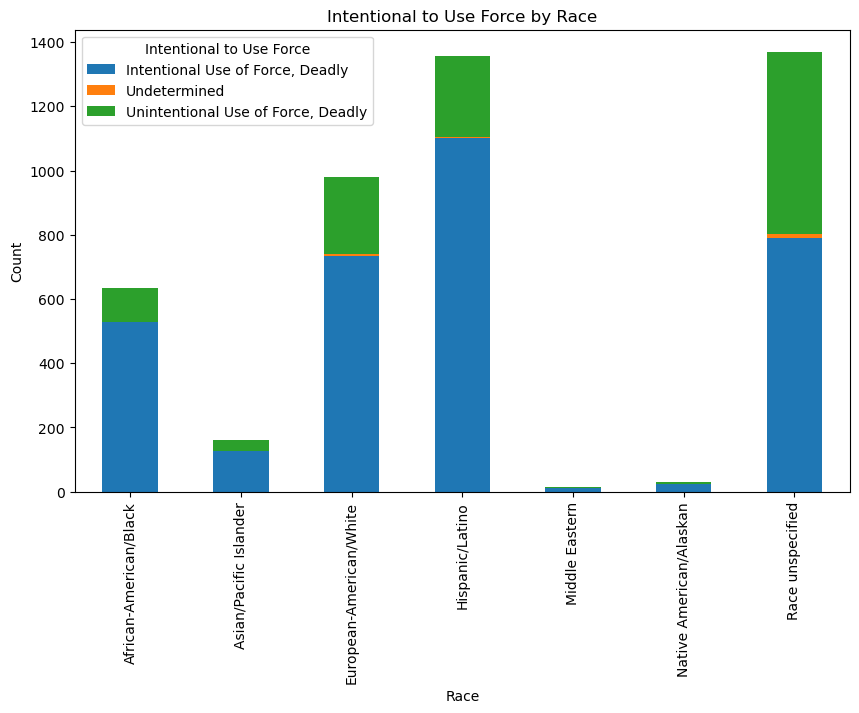

In [35]:
# Group the data by 'Race' and 'Intention_to_Use_Force' and count the occurrences
grouped = graphs_df.groupby(['Subjects_race', 'Intentional_Use_of_Force_(Developing)']).size().unstack(fill_value=0)

# Create a bar chart and overlay the intention to use force
ax = grouped.plot(kind='bar', stacked=True, figsize=(10, 6))

# Customize the plot (add labels, legend, etc.)
plt.xlabel('Race')
plt.ylabel('Count')
plt.title('Intentional to Use Force by Race')
plt.legend(title='Intentional to Use Force', loc='upper left')

# Show the plot
plt.show()

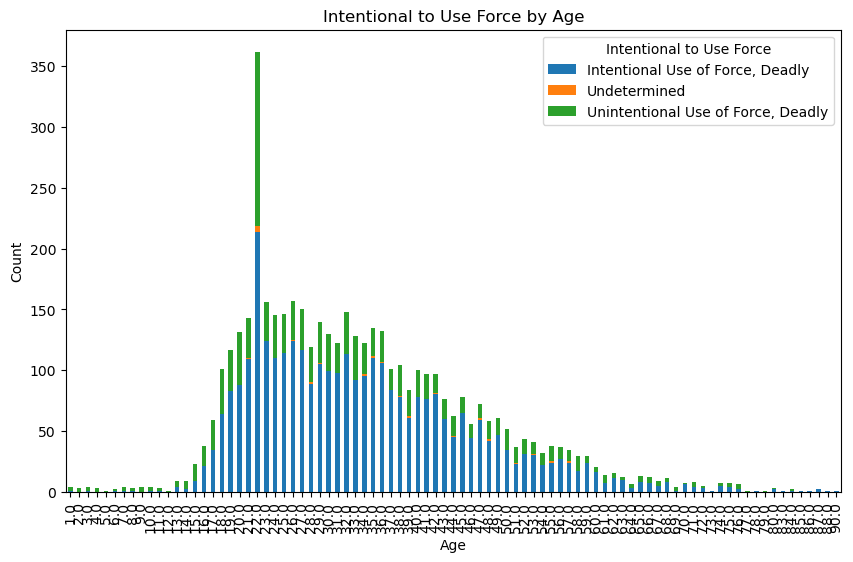

In [36]:
# Group the data by 'Age' and 'Intention_to_Use_Force' and count the occurrences
grouped = graphs_df.groupby(['Subjects_age', 'Intentional_Use_of_Force_(Developing)']).size().unstack(fill_value=0)

# Create a bar chart and overlay the intention to use force
ax = grouped.plot(kind='bar', stacked=True, figsize=(10, 6))

# Customize the plot (add labels, legend, etc.)
plt.xlabel('Age')
plt.ylabel('Count')
plt.title('Intentional to Use Force by Age')
plt.legend(title='Intentional to Use Force', loc='upper right')

# Show the plot
plt.show()

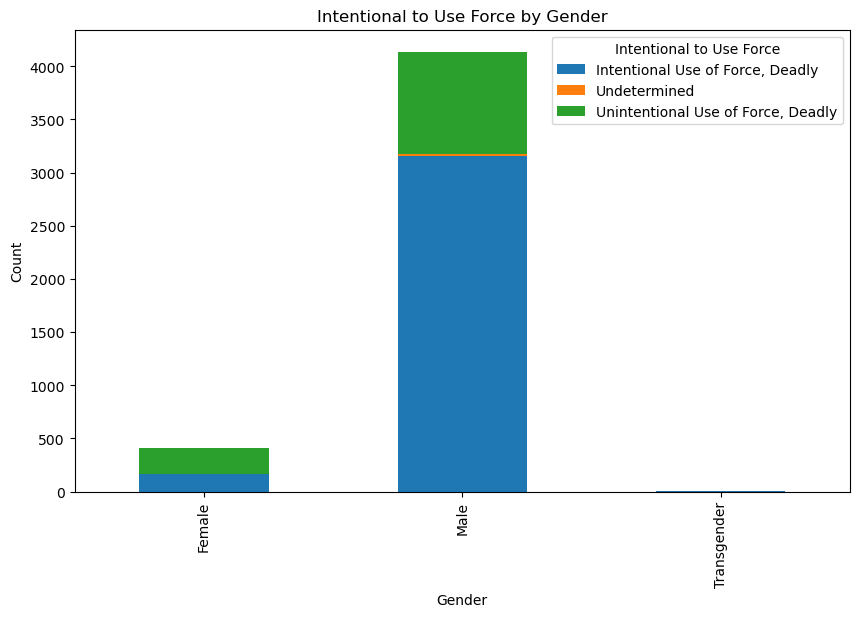

In [37]:
# Group the data by 'Gender' and 'Intention_to_Use_Force' and count the occurrences
grouped = graphs_df.groupby(['Subjects_gender', 'Intentional_Use_of_Force_(Developing)']).size().unstack(fill_value=0)

# Create a bar chart and overlay the intention to use force
ax = grouped.plot(kind='bar', stacked=True, figsize=(10, 6))

# Customize the plot (add labels, legend, etc.)
plt.xlabel('Gender')
plt.ylabel('Count')
plt.title('Intentional to Use Force by Gender')
plt.legend(title='Intentional to Use Force', loc='upper right')

# Show the plot
plt.show()

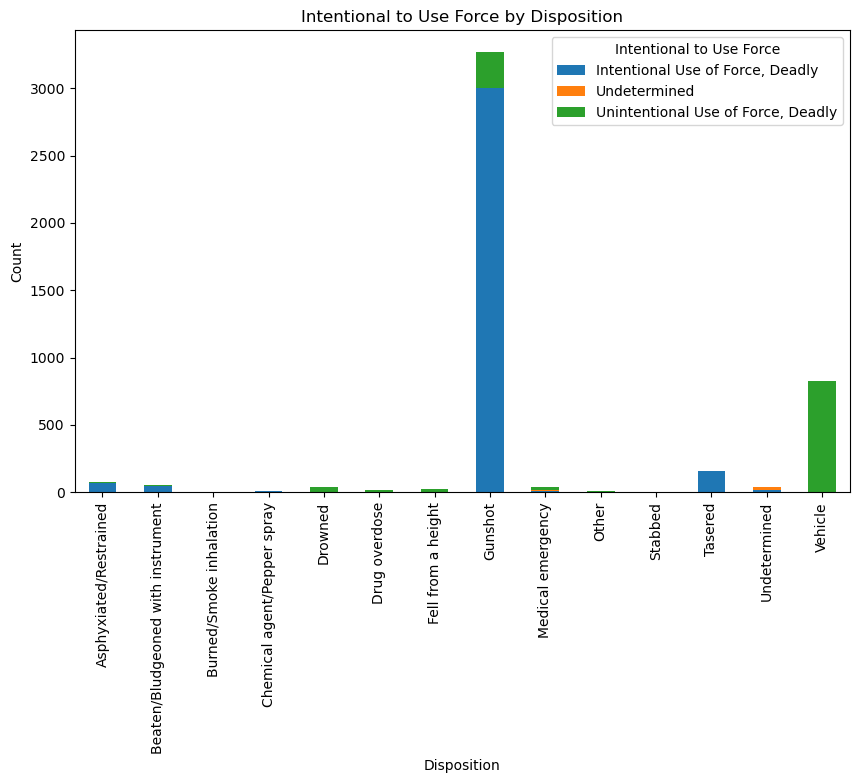

In [38]:
# Group the data by 'Cause of Death' and 'Intention_to_Use_Force' and count the occurrences
grouped = graphs_df.groupby(['Cause_of_death', 'Intentional_Use_of_Force_(Developing)']).size().unstack(fill_value=0)

# Create a bar chart and overlay the intention to use force
ax = grouped.plot(kind='bar', stacked=True, figsize=(10, 6))

# Customize the plot (add labels, legend, etc.)
plt.xlabel('Disposition')
plt.ylabel('Count')
plt.title('Intentional to Use Force by Disposition')
plt.legend(title='Intentional to Use Force', loc='upper right')

# Show the plot
plt.show()

### Contigency Tables

In [39]:
# define target column 
target_column = 'Cause_of_death'

# create an empty array to store the results
chi2_results = []

# iterate through all columns (without the target column)
for column in ca_df.columns:
    if column != target_column:
        cross_tab = pd.crosstab(index=ca_df[column], columns=ca_df[target_column])
        chi2, p, dof, expected = chi2_contingency(cross_tab)
        chi2_results.append({
            'Variable': column,
            'Chi-Square Value': chi2,
            'P-Value': p,
            'Degrees of Freedom': dof
        })

# display results 
chi2_df = pd.DataFrame(chi2_results)
chi2_df

,Variable,Chi-Square Value,P-Value,Degrees of Freedom
0,Unique_ID,59124.000000,4.841482e-01,59111
1,Subjects_age,1710.108426,1.275170e-27,1118
2,Subjects_gender,499.696272,4.030832e-89,26
3,Subjects_race,191.762870,1.449316e-11,78
4,Location_of_injury_(address),55884.447874,4.379805e-02,55315
5,Location_of_death_(city),10834.579335,1.137971e-32,9139
6,Location_of_death_(county),1283.730930,1.245392e-36,702
7,Latitude,57265.138598,4.869947e-08,55471
8,Longitude,57265.138598,3.929518e-08,55458
9,Agency_responsible_for_death,9231.163126,2.482851e-39,7514


In [40]:
# define target column 
target_column = 'Intentional_Use_of_Force_(Developing)'

# create an empty array to store the results
chi2_results = []

# iterate through all columns (without the target column)
for column in ca_df.columns:
    if column != target_column:
        cross_tab = pd.crosstab(index=ca_df[column], columns=ca_df[target_column])
        chi2, p, dof, expected = chi2_contingency(cross_tab)
        chi2_results.append({
            'Variable': column,
            'Chi-Square Value': chi2,
            'P-Value': p,
            'Degrees of Freedom': dof
        })

# display results 
chi2_df = pd.DataFrame(chi2_results)
chi2_df

,Variable,Chi-Square Value,P-Value,Degrees of Freedom
0,Unique_ID,31836.000000,4.878803e-01,31829
1,Subjects_age,973.562079,5.252351e-20,602
2,Subjects_gender,434.081105,8.213261e-84,14
3,Subjects_race,342.647123,8.687141e-49,42
4,Location_of_injury_(address),30890.816069,3.757128e-06,29785
5,Location_of_death_(city),7257.715397,1.040673e-94,4921
6,Location_of_death_(county),615.277636,1.318081e-13,378
7,Latitude,31376.689052,6.376562e-10,29869
8,Longitude,31376.689052,5.340616e-10,29862
9,Agency_responsible_for_death,7248.872701,7.372474e-186,4046


In [41]:
# create contigency table for 'Intentional_Use_of_Force_(Developing)' and 'Cause_of_death'
contingency_force = pd.crosstab(ca_df['Intentional_Use_of_Force_(Developing)'], ca_df ['Cause_of_death'])

contingency_force

Cause_of_death,Asphyxiated/Restrained,Beaten/Bludgeoned with instrument,Burned/Smoke inhalation,Chemical agent/Pepper spray,Drowned,Drug overdose,Fell from a height,Gunshot,Medical emergency,Other,Stabbed,Tasered,Undetermined,Vehicle
Intentional_Use_of_Force_(Developing),,,,,,,,,,,,,,
"Intenional Use of Force, Deadly",0,0,0,0,0,0,0,21,0,0,0,0,0,0
"Intentional Use of Force, Deadly",0,0,0,0,0,0,0,2977,0,1,1,0,0,0
No,0,1,0,0,35,12,13,0,29,0,2,0,3,0
Pursuit,0,0,0,0,0,0,0,0,0,0,0,0,0,4
Suicide,1,0,1,0,1,1,7,269,0,1,2,2,0,1
Undetermined,0,0,0,0,0,1,0,0,1,0,0,0,23,0
Vehicle/Pursuit,0,0,0,0,0,0,0,0,0,0,0,0,0,820
Yes,72,49,4,7,0,0,1,0,12,4,0,155,14,0


In [42]:
# create contigency table for 'Intentional_Use_of_Force_(Developing)' and 'Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS'
contingency_disposition = pd.crosstab(ca_df['Intentional_Use_of_Force_(Developing)'], ca_df['Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS'])

contingency_disposition

"Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS",Accidental,Administrative discipline,Administrative discipline/Civil suit/Family awarded money,Civil suit/Family awarded money,Civil suit/Pending,Civil suit/Results unreported,Cleared,Criminal,Criminal/Off-duty,Drug overdose,...,Pending investigation,Possible suicide,Possibly suicide,Ruled accidental,Ruled suicide,Ruled suicide by police,Suicide,Unknown,Unreported,Use of force justified
Intentional_Use_of_Force_(Developing),,,,,,,,,,,,,,,,,,,,,
"Intenional Use of Force, Deadly",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,2,19,0
"Intentional Use of Force, Deadly",2,2,2,6,1,0,53,19,1,0,...,740,1,1,0,0,1,0,162,1252,3
No,9,1,0,0,0,0,7,1,0,0,...,12,0,0,1,0,0,0,6,53,2
Pursuit,0,0,0,0,0,0,0,0,0,0,...,2,0,0,0,0,0,0,0,2,0
Suicide,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,67,0,219,0,0,0
Undetermined,0,0,0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,1,23,0
Vehicle/Pursuit,8,1,0,1,0,1,31,62,0,0,...,88,0,0,1,0,0,0,53,565,0
Yes,12,0,0,1,1,1,57,2,0,1,...,61,0,0,1,0,0,0,13,134,0


In [43]:
# create contigency table for 'Cause_of_death' and 'Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS'
contingency_death = pd.crosstab(ca_df['Cause_of_death'], ca_df['Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS'])

contingency_death

"Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS",Accidental,Administrative discipline,Administrative discipline/Civil suit/Family awarded money,Civil suit/Family awarded money,Civil suit/Pending,Civil suit/Results unreported,Cleared,Criminal,Criminal/Off-duty,Drug overdose,...,Pending investigation,Possible suicide,Possibly suicide,Ruled accidental,Ruled suicide,Ruled suicide by police,Suicide,Unknown,Unreported,Use of force justified
Cause_of_death,,,,,,,,,,,,,,,,,,,,,
Asphyxiated/Restrained,4,0,0,0,0,0,17,0,0,0,...,15,0,0,0,0,0,1,4,26,0
Beaten/Bludgeoned with instrument,2,0,0,0,0,1,7,1,0,0,...,9,0,0,0,0,0,0,5,17,0
Burned/Smoke inhalation,0,0,0,0,0,0,0,1,0,0,...,0,0,0,0,0,0,1,0,3,0
Chemical agent/Pepper spray,0,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,5,0
Drowned,3,0,0,0,0,0,0,0,0,0,...,6,0,0,0,0,0,1,3,23,0
Drug overdose,4,1,0,0,0,0,2,0,0,0,...,0,0,0,0,0,0,1,1,4,0
Fell from a height,1,0,0,0,0,0,1,0,0,0,...,1,0,0,0,2,0,5,2,9,0
Gunshot,2,2,2,5,1,0,53,19,1,0,...,740,1,1,0,64,1,205,163,1271,3
Medical emergency,1,0,0,0,0,0,3,0,0,0,...,11,0,0,1,0,0,0,0,21,2


### ANOVA (Cause of Death and Numerical Values)

In [44]:
# ANOVA between numberical variables and Cause of Death 

for predictor in ['Subjects_age', 'Latitude', 'Longitude', 'Injury_Year']:
    grouped_data = [ca_df[predictor][ca_df['Cause_of_death'] == category] for category in ca_df['Cause_of_death'].unique()]
    f_statistic, p_value = stats.f_oneway(*grouped_data)
    print(f'{predictor} vs. Cause of Death:')
    print(f'F-statistic: {f_statistic}')
    print(f'P-value: {p_value}\n')

Subjects_age vs. Cause of Death:
F-statistic: 5.728529438692074
P-value: 1.4891504337475343e-10

Latitude vs. Cause of Death:
F-statistic: 3.7049401522931693
P-value: 6.624725458629456e-06

Longitude vs. Cause of Death:
F-statistic: 2.0464365900729953
P-value: 0.014292850594702793

Injury_Year vs. Cause of Death:
F-statistic: 5.123165376161279
P-value: 3.993013836667257e-09



### Text Analysis (brief description column)

In [45]:
# create variable which contains the column 'A_brief_description_of_the_circumstances_surrounding_the_death'
# to oerform text analysis 

corpus = ca_df['A_brief_description_of_the_circumstances_surrounding_the_death']

corpus.tail()

4543    Reports of a robbery at C.V. Guns & Tackle cam...
4544    About 1 a.m., deputies responded to a burglary...
4545    Around 9:30 a.m., deputies responded to a susp...
4546    Border Patrol agents briefly chased the car be...
4547    Louis Lane showed up at theWalmart distributio...
Name: A_brief_description_of_the_circumstances_surrounding_the_death, dtype: object

In [47]:
corpus.describe() # column has 4338 unique values with a total count of 4548 values 

count                                                  4548
unique                                                 4338
top       A car stolen at knifepoint and doing 80 MPH on...
freq                                                      8
Name: A_brief_description_of_the_circumstances_surrounding_the_death, dtype: object

In [48]:
# tfidfVectorizer
vectorizer = TfidfVectorizer()

# apply vectorizer tp corpus
spmat = vectorizer.fit_transform(corpus)

In [49]:
# create new df 'X'
X = pd.DataFrame.sparse.from_spmatrix(spmat)

In [50]:
# create a label vraiable 
labels = ca_df['Cause_of_death']

# subset labels that have text data present
text_subset = labels.loc[corpus.index]

text_subset

0                                 Vehicle
1                                 Vehicle
2                                 Gunshot
3       Beaten/Bludgeoned with instrument
4                                 Gunshot
                      ...                
4543                              Gunshot
4544                              Gunshot
4545                              Gunshot
4546                              Vehicle
4547                              Gunshot
Name: Cause_of_death, Length: 4548, dtype: object

In [51]:
# split the data
X_train, X_test, y_train, y_test = train_test_split(X, text_subset,
                                                    test_size=0.50)

In [52]:
# feature selection
X_new = SelectKBest(score_func=f_classif, k=10)

# fit selector on training data
X_new.fit(X_train, y_train)

# transform training and test data
X_train_selected = X_new.transform(X_train)
X_test_selected = X_new.transform(X_test)

In [53]:
# print top 10 features
print('Top 10 features %s' % X_train.columns[X_new.get_support()].tolist())

Top 10 features [967, 1627, 3038, 3758, 4608, 5116, 5902, 6388, 8506, 10157]


In [54]:
# retrieve feature names
feature_names = vectorizer.get_feature_names_out()
selected_indices = X_new.get_support(indices=True)

# Top 10 selected words
print('Top 10 selected words:', [feature_names[i] for i in selected_indices])

Top 10 selected words: ['barnett', 'campsite', 'drowned', 'frances', 'hypodermic', 'kerry', 'mcclelland', 'needles', 'slitting', 'yerby']


In [55]:
# drop 'A_brief_description_of_the_circumstances_surrounding_the_death'
ca_df.drop(columns=['A_brief_description_of_the_circumstances_surrounding_the_death'], inplace=True)

The 'A_brief_description_of_the_circumstances_surrounding_the_death' column contains words that are irrelevant to the analysis of police fatalities. By removing this column, we streamline our dataset, enhance data quality, and focus our analysis on more pertinent factors, such as location, demographics, and agencies involved, ensuring a more meaningful and accurate examination of the problem.

### Variable Importance

In [56]:
# define the target variable
X_numeric = ca_df.select_dtypes(include=['float64', 'int64'])

# create a df for VIF values
vif = pd.DataFrame()
vif["Variable"] = X_numeric.columns
vif["VIF"] = [variance_inflation_factor(X_numeric.values, i) for i in range(X_numeric.shape[1])]
print(vif)

       Variable          VIF
0  Subjects_age     7.910802
1      Latitude   619.574063
2     Longitude  5247.403991
3  Injury_Month     4.490479
4   Injury_Year  3247.224988


Based on the variable importance analysis, it is advisable to remove the columns 'Latitude,' 'Longitude,' and 'Injury_Year.' High multicollinearity, as observed in these columns, can diminish interpretability and undermine the significance of variables genuinely associated with the target variable.

In [57]:
# drop redudant columns that will not be used for modeling/habe high VIF and low p-values 
ca_df.drop(columns=['Latitude', 'Longitude','Location_of_injury_(address)',
                    'Injury_Year'],inplace=True)

## Data Pre-Processing

In [58]:
# print values within the column 'Intentional_Use_of_Force_(Developing)'
ca_df['Intentional_Use_of_Force_(Developing)'].unique()

array(['Vehicle/Pursuit', 'Intentional Use of Force, Deadly', 'Yes',
       'Suicide', 'No', 'Undetermined', 'Intenional Use of Force, Deadly',
       'Pursuit'], dtype=object)

In [59]:
# map values into two categories intentional use of force and not intentional

# define the mapping of values to categories
mapping = {
    'Vehicle/Pursuit': 'Not intentional',
    'Intentional Use of Force, Deadly': 'Intentional Use of Force, Deadly',
    'Yes': 'Intentional Use of Force, Deadly',
    'Suicide': 'Not intentional',
    'No': 'Not intentional',
    'Undetermined': 'Not intentional',
    'Intenional Use of Force, Deadly': 'Intentional Use of Force, Deadly', 
    'Pursuit': 'Not intentional', 
}

# replace values based on the mapping
force_df = ca_df['Intentional_Use_of_Force_(Developing)'].map(mapping)

# verify the result
force_df.unique()

array(['Not intentional', 'Intentional Use of Force, Deadly'],
      dtype=object)

In [60]:
# value count of force_df (y variable)
force_df.value_counts() #Intentional and not intentional appear to be unbalanced 

Intentional Use of Force, Deadly    3318
Not intentional                     1230
Name: Intentional_Use_of_Force_(Developing), dtype: int64

### Encoding Data

In [61]:
# create a copy of ca_df 
filtered_encoded_df = ca_df.copy()

# identify categorical columns
categorical_columns = categorical_columns = ['Subjects_gender', 'Subjects_race', 'Location_of_death_(city)', 
                                             'Location_of_death_(county)', 'Agency_responsible_for_death',
                                             'Cause_of_death','Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS',  
                                             'Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS'
]

# create df for categorical features
cat_df = filtered_encoded_df[categorical_columns]


# one-hot encoding with handle_unknown='ignore'
encoder = OneHotEncoder(handle_unknown='ignore', sparse=False)
encoded_cat = encoder.fit_transform(cat_df)

# get the feature names after encoding
feature_names = encoder.get_feature_names_out(input_features=categorical_columns)

# fill missing values in the encoded DataFrame
encoded_df = pd.DataFrame(encoded_cat, columns=feature_names)
encoded_df.fillna(0, inplace=True) 

# concatenate the original df and df with encoded features
# drop the categorical columns from ca_df
ca_df = ca_df.drop(columns=categorical_columns)
encoded_df = pd.concat([ca_df, encoded_df], axis=1)

In [63]:
# check for null values 
encoded_df.isna().sum() #df appears to have no null values after encoding 

Unique_ID                                                                         0
Subjects_age                                                                      0
Intentional_Use_of_Force_(Developing)                                             0
Injury_Month                                                                      0
Subjects_gender_Female                                                            0
                                                                                 ..
Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS_Use of force justified     0
Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS_Drug or alcohol use    0
Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS_No                     0
Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS_Unknown                0
Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS_Yes                    0
Length: 1404, dtype: int64

In [64]:
encoded_df.shape # encoded df has 4548 rows and 1404 columns 

(4548, 1404)

### Principal Componet Analysis (PCA) 

In [65]:
# create a copy of encoded_df before applying PCA 
pca_df = encoded_df.copy()

In [66]:
# drop preidctor varaible ('Intentional_Use_of_Force_(Developing)')
pca_df = pca_df.drop('Intentional_Use_of_Force_(Developing)', axis=1)

In [68]:
# standardize the data
scaler = StandardScaler()
encoded_standardized = scaler.fit_transform(pca_df)

In [69]:
# apply PCA
pca = PCA()
pca.fit(encoded_standardized)

# calculate the cumulative explained variance ratio
explained_variance_ratio_cumulative = np.cumsum(pca.explained_variance_ratio_)

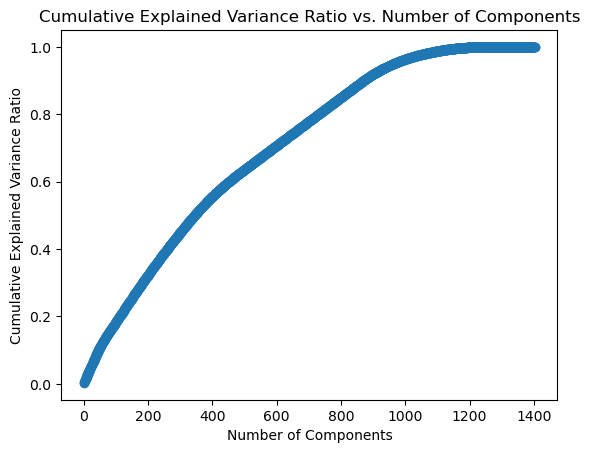

In [70]:
# plot cumulative explained variance ratio
plt.plot(range(1, len(explained_variance_ratio_cumulative) + 1), explained_variance_ratio_cumulative, marker='o')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance Ratio')
plt.title('Cumulative Explained Variance Ratio vs. Number of Components')
plt.show()

In [71]:
# find the number of components that fall within 80% to 90% cumulative explained variance
target_variance_range = (0.80, 0.90)
target_components = np.where((explained_variance_ratio_cumulative >= target_variance_range[0]) &
                             (explained_variance_ratio_cumulative <= target_variance_range[1]))[0][0] + 1

print("Ideal number of components within 80% to 90% variance range:", target_components)

Ideal number of components within 80% to 90% variance range: 730


Through principal component analysis (PCA), it has been established that the optimal number of components to retain falls within the variance range of 80% to 90%, and this ideal number is found to be 730. Out of the 1404 columns in the dataframe, only 730 will be used to build the model.

### Data Splitting

In [72]:
# create a copy of encoded_standardized df
ca_df = encoded_standardized.copy()

In [73]:
# split the dataset to predict whether death was intentional 
X = ca_df
y = force_df #Intentional_Use_of_Force_(Developing)is stored in its own df 

# split data into 60/40 split creating a temp set to store the validation and test
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.4, random_state=42)

# split reaming data from temp ste into test and validation 50/50 split 
X_valid, X_test, y_valid, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

# scale the train & test set
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)
X_valid_scaled = scaler.transform(X_valid)

# Apply PCA with 730 components
n_components = 730
pca = PCA(n_components=n_components)
X_train_pca = pca.fit_transform(X_train_scaled)
X_test_pca = pca.transform(X_test_scaled)
X_valid_pca = pca.transform(X_valid_scaled)


# print the dimensions of X_train_pca and X_test_pca
print("Dimensions of X_train_pca:", X_train_pca.shape)
print("Dimensions of X_test_pca:", X_test_pca.shape)
print("Dimensions of X_valid_pca:", X_valid_pca.shape)

Dimensions of X_train_pca: (2728, 730)
Dimensions of X_test_pca: (910, 730)
Dimensions of X_valid_pca: (910, 730)


During PCA application, the columns lose their original labels. However, the process involves the selection of vital components and the subsequent generation of new DataFrames containing the transformed data, ensuring that the initial feature names are retained as column identifiers for reference and analysis.

In [74]:
# retrive original feature names from df and store them  in the variable
original_feature_names = pca_df.columns

# create df for PCA-transformed data with original feature names from pca_df
selected_feature_indices = pca.components_.argsort()[:, ::-1][:, :n_components]
selected_feature_names = original_feature_names[selected_feature_indices[0]]
X_train_pca_df = pd.DataFrame(X_train_pca, columns=selected_feature_names)
X_test_pca_df = pd.DataFrame(X_test_pca, columns=selected_feature_names)

## Models

### Naive Bayes

In [75]:
# build and fit the Naive Bayes classifier 
nb_clf = GaussianNB()

# fit to data 
nb_clf.fit(X_train_pca, y_train)

# predict on the train set
nb_pred = nb_clf.predict(X_train_pca)
nb_prob = nb_clf.predict_proba(X_train_pca)[:, 1]

# calculate the confusion matrix
cm = confusion_matrix(y_train, nb_pred)

# calculate specificity, sensitivity (recall), F1 score, ROC-AUC
tn, fp, fn, tp = cm.ravel()

nb_specificity = tn / (tn + fp)
nb_sensitivity = tp / (tp + fn)
nb_f1 = f1_score(y_train, nb_pred, pos_label='Intentional Use of Force, Deadly')
nb_acc = accuracy_score(y_train, nb_pred)
nb_roc_auc = roc_auc_score(y_train, nb_prob)

print ("Train Set Metrics")
print("Confusion Matrix:")
print(cm)
print("Accuracy:", nb_acc)
print("Specificity:", nb_specificity)
print("Sensitivity (Recall):", nb_sensitivity)
print("F1 Score:", nb_f1)
print("ROC-AUC Score:", nb_roc_auc)

Train Set Metrics
Confusion Matrix:
[[1686  325]
 [ 450  267]]
Accuracy: 0.7159090909090909
Specificity: 0.8383888612630532
Sensitivity (Recall): 0.3723849372384937
F1 Score: 0.8131179165661924
ROC-AUC Score: 0.7338373256711518


In [76]:
# define the hyperparameter grid
param_grid = {
    'var_smoothing': [1e-9, 1e-8, 1e-7],
}

# create new Gradient Boosting classifier
nb_clf = GaussianNB()

# preform grid search with cross validation and fit to data
grid_search = GridSearchCV(nb_clf, param_grid, cv=5, scoring='accuracy', n_jobs=-1)
grid_search.fit(X_train_scaled, y_train)

# get the best parameters and best estimator
best_params = grid_search.best_params_
best_estimator = grid_search.best_estimator_

print("Best Parameters:", best_params)
print("Best Estimator:", best_estimator)

Best Parameters: {'var_smoothing': 1e-09}
Best Estimator: GaussianNB()


In [77]:
# build and fit new Multilayer Perceptron classifier 
nb_clf = GaussianNB(var_smoothing = 1e-09)

# fit to data 
nb_clf.fit(X_train_pca, y_train)

# predict on the test set
nb_pred = nb_clf.predict(X_test_pca)
nb_prob = nb_clf.predict_proba(X_test_pca)[:, 1]

# calculate the confusion matrix
cm = confusion_matrix(y_test, nb_pred)

# calculate specificity, sensitivity (recall), F1 score, ROC-AUC
tn, fp, fn, tp = cm.ravel()

nb_2_specificity = tn / (tn + fp)
nb_2_sensitivity = tp / (tp + fn)
nb_2_f1 = f1_score(y_test, nb_pred, pos_label='Intentional Use of Force, Deadly')
nb_2_acc = accuracy_score(y_test, nb_pred)
nb_roc2_auc = roc_auc_score(y_test, nb_prob)

print ("Test Set Metrics")
print("Confusion Matrix:")
print(cm)
print("Accuracy:", nb_2_acc)
print("Specificity:", nb_2_specificity)
print("Sensitivity (Recall):", nb_2_sensitivity)
print("F1 Score:", nb_2_f1)
print("ROC-AUC Score:", nb_roc2_auc)

Test Set Metrics
Confusion Matrix:
[[550 100]
 [193  67]]
Accuracy: 0.6780219780219781
Specificity: 0.8461538461538461
Sensitivity (Recall): 0.25769230769230766
F1 Score: 0.7896625987078248
ROC-AUC Score: 0.670207100591716


### Gradient Boosting

In [78]:
# build and fit the Gradient Boosting classifier 
gb_clf = GradientBoostingClassifier(random_state=42)

# fit model to data 
gb_clf.fit(X_train_pca, y_train)

# predict on the train set
gb_pred = gb_clf.predict(X_train_pca)
gb_prob = gb_clf.predict_proba(X_train_pca)[:, 1]

# calculate the confusion matrix
cm = confusion_matrix(y_train, gb_pred)

# calculate specificity, sensitivity (recall), F1 score, ROC-AUC
tn, fp, fn, tp = cm.ravel()

gb_specificity = tn / (tn + fp)
gb_sensitivity = tp / (tp + fn)
gb_f1 = f1_score(y_train, gb_pred, pos_label='Intentional Use of Force, Deadly')
gb_acc = accuracy_score(y_train, gb_pred)
gb_roc_auc = roc_auc_score(y_train, gb_prob)

print ("Train Set Metrics")
print("Confusion Matrix:")
print(cm)
print("Accuracy:", gb_acc)
print("Specificity:", gb_specificity)
print("Sensitivity (Recall):", gb_sensitivity)
print("F1 Score:", gb_f1)
print("ROC-AUC Score:", gb_roc_auc)

Train Set Metrics
Confusion Matrix:
[[2011    0]
 [   2  715]]
Accuracy: 0.999266862170088
Specificity: 1.0
Sensitivity (Recall): 0.99721059972106
F1 Score: 0.9995029821073559
ROC-AUC Score: 0.9999979193931285


In [79]:
# define the hyperparameter grid
param_grid = {
    'learning_rate': [0.01, 0.1, 0.2],
    'n_estimators': [50, 100, 200],
    'max_depth': [3, 4, 5],
    'subsample': [0.8, 1.0],
}

# create a new Gradient Boosting classifier
gb_clf = GradientBoostingClassifier(random_state=42)

# preform grid search with cross validation and fit to data
grid_search = GridSearchCV(gb_clf, param_grid, cv=5, scoring='accuracy', n_jobs=-1)
grid_search.fit(X_train_scaled, y_train)

# get best parameters and best estimator
best_params = grid_search.best_params_
best_estimator = grid_search.best_estimator_

print("Best Parameters:", best_params)
print("Best Estimator:", best_estimator)

Best Parameters: {'learning_rate': 0.2, 'max_depth': 4, 'n_estimators': 200, 'subsample': 0.8}
Best Estimator: GradientBoostingClassifier(learning_rate=0.2, max_depth=4, n_estimators=200,
                           random_state=42, subsample=0.8)


In [80]:
# build and fit the Gradient Boosting classifier using best parameters
gb_clf= GradientBoostingClassifier(learning_rate=0.2, 
                                   max_depth=4,
                                   n_estimators=200,
                                   random_state=42, 
                                   subsample=0.8)
gb_clf.fit(X_train_pca, y_train)

# predict on the test set
gb_pred = gb_clf.predict(X_test_pca)
gb_prob = gb_clf.predict_proba(X_test_pca)[:, 1]

# calculate the confusion matrix
cm = confusion_matrix(y_test, gb_pred)

# calculate specificity, sensitivity (recall), F1 score, ROC-AUC
tn, fp, fn, tp = cm.ravel()

gb_2_specificity = tn / (tn + fp)
gb_2_sensitivity = tp / (tp + fn)
gb_2_f1 = f1_score(y_test, gb_pred, pos_label='Intentional Use of Force, Deadly')
gb_2_acc = accuracy_score(y_test, gb_pred)
gb_roc2_auc = roc_auc_score(y_test, gb_prob)

print ("Test Set Metrics")
print("Confusion Matrix:")
print(cm)
print("Accuracy:", gb_2_acc)
print("Specificity:", gb_2_specificity)
print("Sensitivity (Recall):", gb_2_sensitivity)
print("F1 Score:", gb_2_f1)
print("ROC-AUC Score:", gb_roc2_auc)

Test Set Metrics
Confusion Matrix:
[[639  11]
 [ 39 221]]
Accuracy: 0.945054945054945
Specificity: 0.9830769230769231
Sensitivity (Recall): 0.85
F1 Score: 0.9623493975903614
ROC-AUC Score: 0.9897573964497042


### Multilayer Perceptron 

In [81]:
# build and fit the Multilayer Perceptron classifier 
mlp_clf = MLPClassifier(random_state=42)
mlp_clf.fit(X_train_pca, y_train)

# predict on the train set
mlp_pred = mlp_clf.predict(X_train_pca)
mlp_prob = mlp_clf.predict_proba(X_train_pca)[:, 1]

# calculate the confusion matrix
cm = confusion_matrix(y_train, mlp_pred)

# calculate specificity, sensitivity (recall), F1 score, ROC-AUC
tn, fp, fn, tp = cm.ravel()

mlp_specificity = tn / (tn + fp)
mlp_sensitivity = tp / (tp + fn)
mlp_f1 = f1_score(y_train, mlp_pred, pos_label='Intentional Use of Force, Deadly')
mlp_acc = accuracy_score(y_train, mlp_pred)
mlp_roc_auc = roc_auc_score(y_train, mlp_prob)

print ("Train Set Metrics")
print("Confusion Matrix:")
print(cm)
print("Accuracy:", mlp_acc)
print("Specificity:", mlp_specificity)
print("Sensitivity (Recall):", mlp_sensitivity)
print("F1 Score:", mlp_f1)
print("ROC-AUC Score:", mlp_roc_auc)

Train Set Metrics
Confusion Matrix:
[[2011    0]
 [   0  717]]
Accuracy: 1.0
Specificity: 1.0
Sensitivity (Recall): 1.0
F1 Score: 1.0
ROC-AUC Score: 1.0


In [82]:
# define the hyperparameter grid
param_grid = {
    'hidden_layer_sizes': [(100,), (50, 50), (100, 50)],
    'activation': ['relu', 'tanh'],
    'learning_rate_init': [0.001, 0.01],
    'max_iter': [200, 300],
}

# create a new Multilayer Perceptron classifier
mlp_clf = MLPClassifier(random_state=42)

# preform grid search with cross validation and fit to data
grid_search = GridSearchCV(mlp_clf, param_grid, cv=5, scoring='accuracy', n_jobs=-1)
grid_search.fit(X_train_scaled, y_train)

# get the best parameters and best estimator
best_params = grid_search.best_params_
best_estimator = grid_search.best_estimator_

print("Best Parameters:", best_params)
print("Best Estimator:", best_estimator)

Best Parameters: {'activation': 'relu', 'hidden_layer_sizes': (50, 50), 'learning_rate_init': 0.01, 'max_iter': 200}
Best Estimator: MLPClassifier(hidden_layer_sizes=(50, 50), learning_rate_init=0.01,
              random_state=42)


In [83]:
# build and fit new Multilayer Perceptron classifier 
mlp_clf = MLPClassifier(hidden_layer_sizes=(50, 50), 
                        learning_rate_init=0.01,
                        random_state=42)

mlp_clf.fit(X_train_pca, y_train)

# predict on the test set
mlp_pred = mlp_clf.predict(X_test_pca)
mlp_prob = mlp_clf.predict_proba(X_test_pca)[:, 1]

# calculate the confusion matrix
cm = confusion_matrix(y_test, mlp_pred)

# calculate specificity, sensitivity (recall), F1 score, ROC-AUC
tn, fp, fn, tp = cm.ravel()

mlp_2_specificity = tn / (tn + fp)
mlp_2_sensitivity = tp / (tp + fn)
mlp_2_f1 = f1_score(y_test, mlp_pred, pos_label='Intentional Use of Force, Deadly')
mlp_2_acc = accuracy_score(y_test, mlp_pred)
mlp_roc2_auc = roc_auc_score(y_test, mlp_prob)

print ("Test Set Metrics")
print("Confusion Matrix:")
print(cm)
print("Accuracy:", mlp_2_acc)
print("Specificity:", mlp_2_specificity)
print("Sensitivity (Recall):", mlp_2_sensitivity)
print("F1 Score:", mlp_2_f1) 
print("ROC-AUC Score:", mlp_roc2_auc)

Test Set Metrics
Confusion Matrix:
[[621  29]
 [ 21 239]]
Accuracy: 0.945054945054945
Specificity: 0.9553846153846154
Sensitivity (Recall): 0.9192307692307692
F1 Score: 0.9613003095975232
ROC-AUC Score: 0.9593550295857987


### Linear Discriminant Analysis

In [84]:
# define LDA model and fit to data 
lda_clf = LinearDiscriminantAnalysis()
lda_clf.fit(X_train_pca, y_train)

# predict on training data 
lda_pred = lda_clf.predict(X_train_pca)
lda_prob = lda_clf.predict_proba(X_train_pca)[:, 1]

# calculate the confusion matrix
cm = confusion_matrix(y_train, lda_pred)

# calculate specificity, sensitivity (recall), F1 score, ROC-AUC
tn, fp, fn, tp = cm.ravel()

lda_specificity = tn / (tn + fp)
lda_sensitivity = tp / (tp + fn)
lda_f1 = f1_score(y_train, lda_pred, pos_label='Intentional Use of Force, Deadly') 
lda_acc = accuracy_score(y_train, lda_pred)
lda_roc_auc = roc_auc_score(y_train, lda_prob)

print ("Train Set Metrics")
print("Confusion Matrix:")
print(cm)
print("Accuracy:", lda_acc)
print("Specificity:", lda_specificity)
print("Sensitivity (Recall):", lda_sensitivity)
print("F1 Score:", lda_f1)
print("ROC-AUC Score:", lda_roc_auc)

Train Set Metrics
Confusion Matrix:
[[1998   13]
 [   9  708]]
Accuracy: 0.9919354838709677
Specificity: 0.9935355544505221
Sensitivity (Recall): 0.9874476987447699
F1 Score: 0.9945246391239422
ROC-AUC Score: 0.9994125753266379


In [85]:
# define the hyperparameter grid for LDA
param_grid = {
    'solver': ['lsqr', 'eigen', 'svd'],
    'shrinkage': [None, 'auto', 0.1, 0.2, 0.3],
    'priors': [None, [0.3, 0.7], [0.4, 0.6], [0.5, 0.5]],
}

# create a new LDA classifier
lda_clf = LinearDiscriminantAnalysis()

# perform grid search with cross-validation and fit to data
grid_search = GridSearchCV(lda_clf, param_grid, cv=5, scoring='accuracy', n_jobs=-1)
grid_search.fit(X_train, y_train)

# get the best parameters and best estimator
best_params = grid_search.best_params_
best_estimator = grid_search.best_estimator_

print("Best Parameters:", best_params)
print("Best Estimator:", best_estimator)

Best Parameters: {'priors': None, 'shrinkage': 0.2, 'solver': 'lsqr'}
Best Estimator: LinearDiscriminantAnalysis(shrinkage=0.2, solver='lsqr')


In [86]:
# build and fit LDA classifier using best parameters
lda_clf = LinearDiscriminantAnalysis(shrinkage=0.2,
                                     solver='lsqr')

lda_clf.fit(X_train_pca, y_train)

# predict on the test set            
lda_pred = lda_clf.predict(X_test_pca)
lda_prob = lda_clf.predict_proba(X_test_pca)[:, 1]

# calculate the confusion matrix
cm = confusion_matrix(y_test, lda_pred)

# calculate specificity, sensitivity (recall), F1 score, ROC-AUC
tn, fp, fn, tp = cm.ravel()

lda_2_specificity = tn / (tn + fp)
lda_2_sensitivity = tp / (tp + fn)
lda_2_f1 = f1_score(y_test, lda_pred, pos_label='Intentional Use of Force, Deadly')  
lda_2_acc = accuracy_score(y_test, lda_pred)
lda_roc2_auc = roc_auc_score(y_test, lda_prob)

print ("Test Set Metrics")
print("Confusion Matrix:")
print(cm)
print("Accuracy:", lda_2_acc)
print("Specificity:", lda_2_specificity)
print("Sensitivity (Recall):", lda_2_sensitivity)
print("F1 Score:", lda_2_f1)
print("ROC-AUC Score:", lda_roc2_auc)

Test Set Metrics
Confusion Matrix:
[[635  15]
 [ 35 225]]
Accuracy: 0.945054945054945
Specificity: 0.9769230769230769
Sensitivity (Recall): 0.8653846153846154
F1 Score: 0.962121212121212
ROC-AUC Score: 0.9896390532544379


### Logistic Regression

In [87]:
# # define models and parameters 
# model = LogisticRegression()
# solvers = ['newton-cg', 'lbfgs', 'liblinear']
# penalty = ['l2']
# c_values = [100, 10, 1.0, 0.1, 0.01]
# # define grid search
# grid = dict(solver=solvers,penalty=penalty,C=c_values)
# cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
# grid_search = GridSearchCV(estimator=model, param_grid=grid, n_jobs=-1,
#                            cv=cv, scoring='accuracy',error_score=0)
# grid_result = grid_search.fit(X_train_pca, y_train)
# # summarize results
# print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))
# means = grid_result.cv_results_['mean_test_score']
# stds = grid_result.cv_results_['std_test_score']
# params = grid_result.cv_results_['params']
# for mean, stdev, param in zip(means, stds, params):
#     print("%f (%f) with: %r" % (mean, stdev, param))

In [88]:
# fit logistic regression
logit_reg = LogisticRegression(penalty='l2', C=0.1, solver='newton-cg')
logit_reg.fit(X_train_pca, y_train)

LogisticRegression(C=0.1, solver='newton-cg')

In [89]:
print('intercept: ', logit_reg.intercept_[0])
pd.DataFrame({'coeff': logit_reg.coef_[0]}, index=X_train_pca_df.columns)

intercept:  -2.8298100458790736


,coeff
"Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_FOR_ANALYSIS_No",0.919700
Subjects_gender_Female,-0.339942
Cause_of_death_Vehicle,-1.188508
Unique_ID,0.171917
"Dispositions/Exclusions_INTERNAL_USE,_NOT_FOR_ANALYSIS_Pending investigation",-0.061691
...,...
"Agency_responsible_for_death_California Highway Patrol, Yuba County Sheriff's Office, Yuba City Police Department, Wheatland Police Department",-0.144031
Agency_responsible_for_death_Capitola Police Department,0.006394
Agency_responsible_for_death_Oakdale Police Department,-0.227616
"Agency_responsible_for_death_Capitola Police Department, Santa Cruz Police Department",0.067970


In [90]:
# predict on the test set            
lda_pred = logit_reg.predict(X_test_pca)
lda_prob = logit_reg.predict_proba(X_test_pca)[:, 1]

# calculate the confusion matrix
cm = confusion_matrix(y_test, lda_pred)

# calculate specificity, sensitivity (recall), F1 score, ROC-AUC
tn, fp, fn, tp = cm.ravel()

lg_specificity = tn / (tn + fp)
lg_sensitivity = tp / (tp + fn)
lg_f1 = f1_score(y_test, lda_pred, pos_label='Intentional Use of Force, Deadly')  
lg_acc = accuracy_score(y_test, logit_reg.predict(X_test_pca))
lg_auc = roc_auc_score(y_test, lda_prob)

print ("Test Set Metrics")
print("Confusion Matrix:")
print(cm)
print("Accuracy:", lg_acc)
print("Specificity:", lg_specificity)
print("Sensitivity (Recall):", lg_sensitivity)
print("F1 Score:", lg_f1)
print("ROC-AUC Score:", lg_auc)

Test Set Metrics
Confusion Matrix:
[[639  11]
 [ 19 241]]
Accuracy: 0.967032967032967
Specificity: 0.9830769230769231
Sensitivity (Recall): 0.926923076923077
F1 Score: 0.9770642201834863
ROC-AUC Score: 0.9880887573964497


### Random Forest

In [91]:
# model = RandomForestClassifier()
# n_estimators = [ 100, 1000, 2000]
# max_features = ['sqrt', 'log2']
# # define grid search
# grid = dict(n_estimators=n_estimators,max_features=max_features)
# cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
# grid_search = GridSearchCV(estimator=model, param_grid=grid, n_jobs=-1, cv=cv, scoring='accuracy',error_score=0)
# grid_result = grid_search.fit(X_train_pca, y_train)
# # summarize results
# print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))
# means = grid_result.cv_results_['mean_test_score']
# stds = grid_result.cv_results_['std_test_score']
# params = grid_result.cv_results_['params']
# for mean, stdev, param in zip(means, stds, params):
#     print("%f (%f) with: %r" % (mean, stdev, param))

In [92]:
# fit random forest with the parameters
rf = RandomForestClassifier(n_estimators=2000, max_features='sqrt', random_state=1)
rf.fit(X_train_pca, y_train)

RandomForestClassifier(n_estimators=2000, random_state=1)

In [93]:
# variable importance plot
importances = rf.feature_importances_
std = np.std([tree.feature_importances_ for tree in rf.estimators_], axis=0)
df = pd.DataFrame({'feature': X_train_pca_df.columns, 'importance': importances, 'std': std})
df = df.sort_values('importance')
print(df)

                                               feature  importance       std
569           Location_of_death_(city)_California City    0.000507  0.001774
457                   Location_of_death_(city)_Cypress    0.000517  0.001650
628                  Location_of_death_(city)_Hesperia    0.000543  0.002057
488  Agency_responsible_for_death_Atwater Police De...    0.000548  0.001711
512                   Location_of_death_(city)_Belmont    0.000548  0.001806
..                                                 ...         ...       ...
56   Agency_responsible_for_death_Richmond Police D...    0.015272  0.024110
702                 Location_of_death_(city)_Templeton    0.017411  0.025470
49   Agency_responsible_for_death_Dinuba Police Dep...    0.021251  0.030064
0    Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_...    0.022405  0.031121
2                               Cause_of_death_Vehicle    0.040150  0.046715

[730 rows x 3 columns]


In [94]:
# predict on the test set            
lda_pred = rf.predict(X_test_pca)
lda_prob = rf.predict_proba(X_test_pca)[:, 1]

# calculate the confusion matrix
cm = confusion_matrix(y_test, lda_pred)

# calculate specificity, sensitivity (recall), F1 score, ROC-AUC
tn, fp, fn, tp = cm.ravel()

rf_specificity = tn / (tn + fp)
rf_sensitivity = tp / (tp + fn)
rf_f1 = f1_score(y_test, lda_pred, pos_label='Intentional Use of Force, Deadly')  
rf_acc = accuracy_score(y_test, lda_pred)
rf_auc = roc_auc_score(y_test, lda_prob)

print ("Test Set Metrics")
print("Confusion Matrix:")
print(cm)
print("Accuracy:", rf_acc)
print("Specificity:", rf_specificity)
print("Sensitivity (Recall):", rf_sensitivity)
print("F1 Score:", rf_f1)
print("ROC-AUC Score:", rf_auc)

Test Set Metrics
Confusion Matrix:
[[633  17]
 [127 133]]
Accuracy: 0.8417582417582418
Specificity: 0.9738461538461538
Sensitivity (Recall): 0.5115384615384615
F1 Score: 0.8978723404255319
ROC-AUC Score: 0.9605739644970415


### Neural Network

In [95]:
# fit neural network
clf = MLPClassifier(hidden_layer_sizes=(3), activation='logistic', solver='lbfgs',random_state=1, max_iter=1000)
clf.fit(X_train_pca,y_train)

MLPClassifier(activation='logistic', hidden_layer_sizes=3, max_iter=1000,
              random_state=1, solver='lbfgs')

In [96]:
# network structure
print('Intercepts')
print(clf.intercepts_)
print('Weights')
print(clf.coefs_)

Intercepts
[array([ 3.35558672,  1.78313912, -0.47994269]), array([9.98968676])]
Weights
[array([[ -2.72556304, -20.3358374 ,  -1.34414656],
       [  0.82427195,   6.82281276,   0.32391926],
       [  4.78460503,  23.14710594,   1.64419155],
       ...,
       [  0.96565207,   2.00720236,   0.25186314],
       [ -0.10997906,  -0.85086681,  -0.22701342],
       [  0.98263964,   1.88482463,   0.52354641]]), array([[-12.50736014],
       [-10.56859424],
       [-11.55438543]])]


In [97]:
# predict on the test set            
lda_pred = clf.predict(X_test_pca)
lda_prob = clf.predict_proba(X_test_pca)[:, 1]

# calculate the confusion matrix
cm = confusion_matrix(y_test, lda_pred)

# calculate specificity, sensitivity (recall), F1 score, ROC-AUC
tn, fp, fn, tp = cm.ravel()

clf_specificity = tn / (tn + fp)
clf_sensitivity = tp / (tp + fn)
clf_f1 = f1_score(y_test, lda_pred, pos_label='Intentional Use of Force, Deadly')  
clf_acc = accuracy_score(y_test, lda_pred)
clf_auc = roc_auc_score(y_test, lda_prob)

print ("Test Set Metrics")
print("Confusion Matrix:")
print(cm)
print("Accuracy:", clf_acc)
print("Specificity:", clf_specificity)
print("Sensitivity (Recall):", clf_sensitivity)
print("F1 Score:", clf_f1)
print("ROC-AUC Score:", clf_auc)

Test Set Metrics
Confusion Matrix:
[[619  31]
 [ 17 243]]
Accuracy: 0.9472527472527472
Specificity: 0.9523076923076923
Sensitivity (Recall): 0.9346153846153846
F1 Score: 0.962674961119751
ROC-AUC Score: 0.9730118343195265


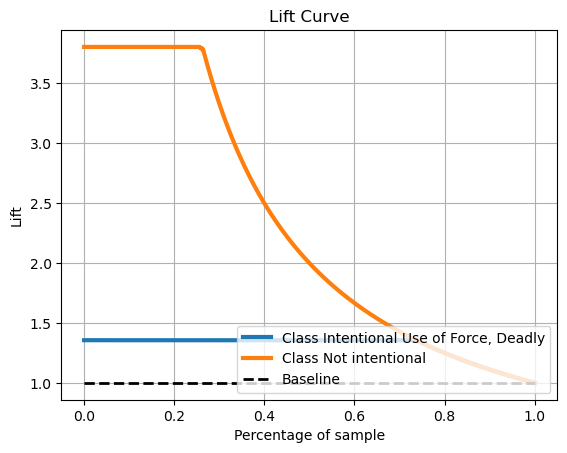

In [98]:
# define predicted with the probabilities from the model
predicted = logit_reg.predict_proba(X_train_pca)

#plot the predicted and initial values.
skplt.metrics.plot_lift_curve(y_train, predicted)
plt.show()

### Logistic Regression - KM

In [99]:
# Logistic Regression model
model = LogisticRegression(random_state=42)

# Train the model on the training data
model.fit(X_train_pca, y_train)

# Make predictions on the test data
y_pred = model.predict(X_test_pca)

# Evaluate the model's performance
log_accuracy = accuracy_score(y_test, y_pred)
log_confusion = confusion_matrix(y_test, y_pred)
log_classification_rep = classification_report(y_test, y_pred)

# Calculate Specificity and Sensitivity
tn, fp, fn, tp = log_confusion.ravel()
log_specificity = tn / (tn + fp)
log_sensitivity = tp / (tp + fn)

print(f'Accuracy: {log_accuracy}')
print(f'Confusion Matrix:\n{log_confusion}')
print(f'Classification Report:\n{log_classification_rep}')
print(f'Specificity: {log_specificity}')
print(f'Sensitivity: {log_sensitivity}')

# Calculate AUC-ROC score
log_roc_auc = roc_auc_score(y_test, model.predict_proba(X_test_pca)[:, 1])
print("AUC-ROC:", log_roc_auc)

Accuracy: 0.9659340659340659
Confusion Matrix:
[[637  13]
 [ 18 242]]
Classification Report:
                                  precision    recall  f1-score   support

Intentional Use of Force, Deadly       0.97      0.98      0.98       650
                 Not intentional       0.95      0.93      0.94       260

                        accuracy                           0.97       910
                       macro avg       0.96      0.96      0.96       910
                    weighted avg       0.97      0.97      0.97       910

Specificity: 0.98
Sensitivity: 0.9307692307692308
AUC-ROC: 0.9797573964497042


In [100]:
# Get the coefficients
log_coefficients = model.coef_[0]
log_feature_name = X_train_pca_df.columns

# Create a DataFrame to display coefficients and feature names
log_coef_df = pd.DataFrame({'Feature': log_feature_name, 'Coefficient': log_coefficients})

# Sort the coefficients by absolute value
log_coef_df['Abs_Coefficient'] = abs(log_coef_df['Coefficient'])
log_sorted_coef_df = log_coef_df.sort_values(by='Abs_Coefficient', ascending=False)

# Display the sorted coefficients
log_sorted_coef_df.head(10)

,Feature,Coefficient,Abs_Coefficient
2,Cause_of_death_Vehicle,-1.777263,1.777263
0,"Symptoms_of_mental_illness?_INTERNAL_USE,_NOT_...",1.325989,1.325989
54,Agency_responsible_for_death_Oakland Police De...,1.215619,1.215619
361,Location_of_death_(city)_Dublin,1.199859,1.199859
66,Agency_responsible_for_death_Pittsburg Police ...,0.977412,0.977412
378,Location_of_death_(city)_Winchester,0.933317,0.933317
58,Location_of_death_(city)_Richmond,-0.864303,0.864303
723,Agency_responsible_for_death_Monterey County S...,0.792418,0.792418
60,Location_of_death_(county)_Placer,0.784076,0.784076
702,Location_of_death_(city)_Templeton,0.783079,0.783079


### Logistic Validation - KM

In [101]:
# Make predictions on the validation data
y_pred = model.predict(X_valid_pca)

# Evaluate the model's performance
log_accuracy = accuracy_score(y_test, y_pred)
log_confusion = confusion_matrix(y_test, y_pred)
log_classification_rep = classification_report(y_test, y_pred)

# Calculate Specificity and Sensitivity
tn, fp, fn, tp = log_confusion.ravel()
log_specificity = tn / (tn + fp)
log_sensitivity = tp / (tp + fn)

print(f'Accuracy: {log_accuracy}')
print(f'Confusion Matrix:\n{log_confusion}')
print(f'Classification Report:\n{log_classification_rep}')
print(f'Specificity: {log_specificity}')
print(f'Sensitivity: {log_sensitivity}')

# Calculate AUC-ROC score
log_roc_auc = roc_auc_score(y_test, model.predict_proba(X_valid_pca)[:, 1])
print("AUC-ROC:", log_roc_auc)

Accuracy: 0.5835164835164836
Confusion Matrix:
[[462 188]
 [191  69]]
Classification Report:
                                  precision    recall  f1-score   support

Intentional Use of Force, Deadly       0.71      0.71      0.71       650
                 Not intentional       0.27      0.27      0.27       260

                        accuracy                           0.58       910
                       macro avg       0.49      0.49      0.49       910
                    weighted avg       0.58      0.58      0.58       910

Specificity: 0.7107692307692308
Sensitivity: 0.2653846153846154
AUC-ROC: 0.5086331360946745


### Decision Tree

In [103]:
#Create the Decision Tree Classifier Instance and then Fit the model to the training data. 
tree1_clf = tree.DecisionTreeClassifier()  # Create a classifier instance
tree1_clf.fit(X_train_pca, y_train)  # Fit the model to the training data

# Using the trained model to make predictions on the test data 
y_pred = tree1_clf.predict(X_test_pca)

# Evaluate the model's performance
tree_accuracy = accuracy_score(y_test, y_pred)
tree_confusion = confusion_matrix(y_test, y_pred)
tree_classification_rep = classification_report(y_test, y_pred)

# Calculate Specificity and Sensitivity
tn1, fp1, fn1, tp1 = tree_confusion.ravel()
tree_specificity = tn1 / (tn1 + fp1)
tree_sensitivity = tp1 / (tp1 + fn1)

print(f'Accuracy: {tree_accuracy}')
print(f'Confusion Matrix:\n{tree_confusion}')
print(f'Classification Report:\n{tree_classification_rep}')
print(f'Specificity: {tree_specificity}')
print(f'Sensitivity: {tree_sensitivity}')

# Calculate AUC-ROC score
tree_roc_auc = roc_auc_score(y_test, tree1_clf.predict_proba(X_test_pca)[:, 1])
print("AUC-ROC:", tree_roc_auc)

Accuracy: 0.856043956043956
Confusion Matrix:
[[591  59]
 [ 72 188]]
Classification Report:
                                  precision    recall  f1-score   support

Intentional Use of Force, Deadly       0.89      0.91      0.90       650
                 Not intentional       0.76      0.72      0.74       260

                        accuracy                           0.86       910
                       macro avg       0.83      0.82      0.82       910
                    weighted avg       0.85      0.86      0.85       910

Specificity: 0.9092307692307692
Sensitivity: 0.7230769230769231
AUC-ROC: 0.8161538461538462


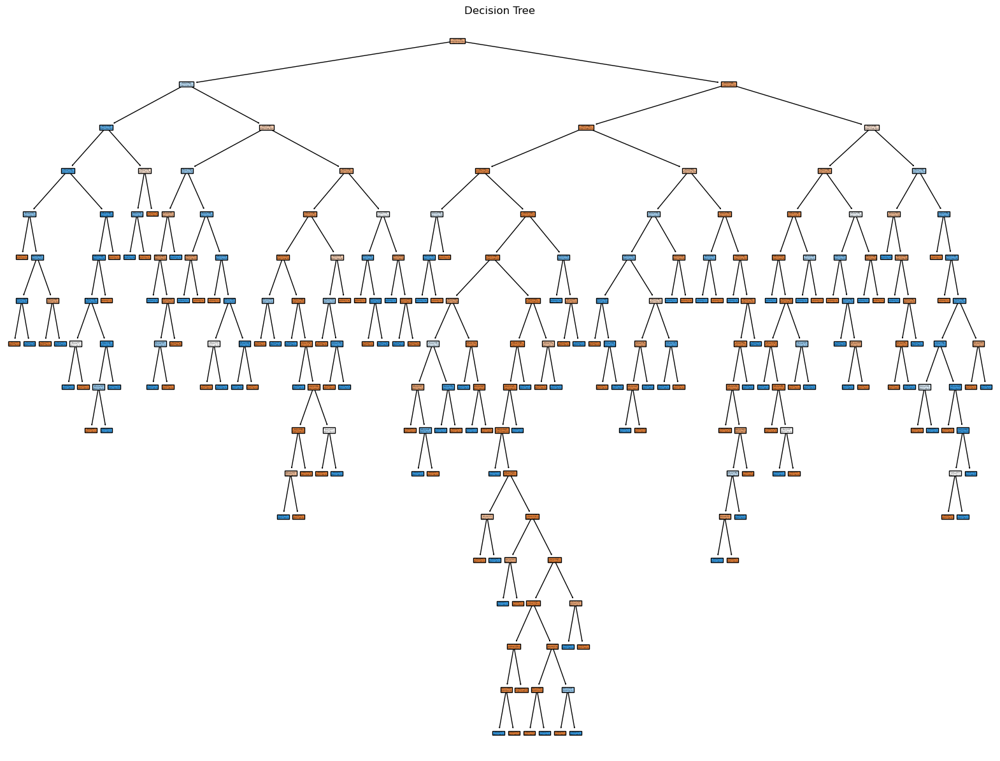

In [105]:
# Plot the decision tree 
# Convert column index to a list of feature names
tree_feature_names = pd.DataFrame(X_test_pca).columns.tolist()


# Plot the decision tree
plt.figure(figsize=(20, 15))  
plot_tree(tree1_clf, filled=True, feature_names=tree_feature_names, class_names=['Class 0', 'Class 1'])
plt.title("Decision Tree")
plt.show()

### Decision Tree Validation 

In [108]:
# Using the trained model to make predictions on the test data 
y_pred = tree1_clf.predict(X_test_pca)

# Evaluate the model's performance
tree_accuracy = accuracy_score(y_test, y_pred)
tree_confusion = confusion_matrix(y_test, y_pred)
tree_classification_rep = classification_report(y_test, y_pred)

# Calculate Specificity and Sensitivity
tn1, fp1, fn1, tp1 = tree_confusion.ravel()
tree_specificity = tn1 / (tn1 + fp1)
tree_sensitivity = tp1 / (tp1 + fn1)
tree_f1 = f1_score(y_test, y_pred, pos_label='Intentional Use of Force, Deadly') 

print(f'Accuracy: {tree_accuracy}')
print(f'Confusion Matrix:\n{tree_confusion}')
print(f'Classification Report:\n{tree_classification_rep}')
print(f'Specificity: {tree_specificity}')
print(f'Sensitivity: {tree_sensitivity}')
print("F1 Score:", tree_f1)

# Calculate AUC-ROC score
tree_roc_auc = roc_auc_score(y_test, tree1_clf.predict_proba(X_test_pca)[:, 1])
print("AUC-ROC:", tree_roc_auc)

Accuracy: 0.856043956043956
Confusion Matrix:
[[591  59]
 [ 72 188]]
Classification Report:
                                  precision    recall  f1-score   support

Intentional Use of Force, Deadly       0.89      0.91      0.90       650
                 Not intentional       0.76      0.72      0.74       260

                        accuracy                           0.86       910
                       macro avg       0.83      0.82      0.82       910
                    weighted avg       0.85      0.86      0.85       910

Specificity: 0.9092307692307692
Sensitivity: 0.7230769230769231
F1 Score: 0.9002284843869002
AUC-ROC: 0.8161538461538462


### Random Forest Classifier

In [ ]:
# Create a Random Forest Classifier with 3 trees
tree2_clf = RandomForestClassifier(n_estimators=3, random_state=42)

# Train the model
tree2_clf.fit(X_train_pca, y_train)

# Make predictions on the test set
y_pred = tree2_clf.predict(X_test_pca)

# Evaluate the model's accuracy
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy:.2f}")

# Evaluate the model's performance
tree2_accuracy = accuracy_score(y_test, y_pred)
tree2_confusion = confusion_matrix(y_test, y_pred)
tree2_classification_rep = classification_report(y_test, y_pred)

# Calculate Specificity and Sensitivity
tn2, fp2, fn2, tp2 = tree2_confusion.ravel()
tree2_specificity = tn2 / (tn2 + fp2)
tree2_sensitivity = tp2 / (tp2 + fn2)

print(f'Accuracy: {tree2_accuracy}')
print(f'Confusion Matrix:\n{tree2_confusion}')
print(f'Classification Report:\n{tree2_classification_rep}')
print(f'Specificity: {tree2_specificity}')
print(f'Sensitivity: {tree2_sensitivity}')

# Calculate AUC-ROC score
tree2_roc_auc = roc_auc_score(y_test, tree2_clf.predict_proba(X_test_pca)[:, 1])
print("AUC-ROC:", tree2_roc_auc)

In [ ]:
# Probability of class 1
tree2_predicted_probabilities = tree2_clf.predict_proba(X_test_pca)[:, 1]  
# tree2_predicted_probabilities

In [ ]:
# Get the individual decision trees from the Random Forest
individual_trees = tree2_clf.estimators_

# Convert feature names to a list
tree2_feature_names = pd.DataFrame(X_train_pca).columns.tolist()

# Plot each tree
for i, tree in enumerate(individual_trees):
    plt.figure(figsize=(15, 10))  
    plot_tree(tree, filled=True, feature_names=tree2_feature_names, class_names=['Class 0', 'Class 1'])
    plt.title(f"Decision Tree {i+1}")
    plt.show()

### Random Forest Validation 

In [ ]:
# Make predictions on the test set
y_pred = tree2_clf.predict(X_valid_pca)

# Evaluate the model's accuracy
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy:.2f}")

# Evaluate the model's performance
tree2_accuracy = accuracy_score(y_test, y_pred)
tree2_confusion = confusion_matrix(y_test, y_pred)
tree2_classification_rep = classification_report(y_test, y_pred)

# Calculate Specificity and Sensitivity
tn2, fp2, fn2, tp2 = tree2_confusion.ravel()
tree2_specificity = tn2 / (tn2 + fp2)
tree2_sensitivity = tp2 / (tp2 + fn2)

print(f'Accuracy: {tree2_accuracy}')
print(f'Confusion Matrix:\n{tree2_confusion}')
print(f'Classification Report:\n{tree2_classification_rep}')
print(f'Specificity: {tree2_specificity}')
print(f'Sensitivity: {tree2_sensitivity}')

# Calculate AUC-ROC score
tree2_roc_auc = roc_auc_score(y_test, tree2_clf.predict_proba(X_valid_pca)[:, 1])
print("AUC-ROC:", tree2_roc_auc)

## Results

In [111]:
# displaying all reuslts in a df 

# create lists to store the scores
model_names = ["MLP Classifier", "Naive Bayes", "Gradient Boosting", "Linear Discriminant Analysis",
              "Logistic Regression", "Random Forest", "Neural Network", "Decision Tree"]
accuracies = [mlp_2_acc, nb_2_acc, gb_2_acc, lda_2_acc, lg_acc, rf_acc, clf_acc, tree_accuracy]
specificities = [mlp_2_specificity, nb_2_specificity, gb_2_specificity, lda_2_specificity
                , lg_specificity, rf_specificity, clf_specificity, tree_specificity]
sensitivities = [mlp_2_sensitivity, nb_2_sensitivity, gb_2_sensitivity, lda_2_sensitivity,
                 lg_sensitivity, rf_sensitivity, clf_sensitivity, tree_sensitivity]
f1_scores = [mlp_2_f1, nb_2_f1, gb_2_f1, lda_2_f1, lg_f1, rf_f1, clf_f1, tree_f1]
roc_auc = [mlp_roc2_auc, nb_roc2_auc, gb_roc2_auc, lda_roc2_auc, lg_auc, rf_auc, clf_auc, tree_roc_auc]

# create df
scores_df = pd.DataFrame({
    "Model": model_names,
    "Accuracy": accuracies,
    "Specificity": specificities,
    "Sensitivity (Recall)": sensitivities,
    "F1 Score": f1_scores,
    "ROC - AUC Score": roc_auc 
})

scores_df

,Model,Accuracy,Specificity,Sensitivity (Recall),F1 Score,ROC - AUC Score
0,MLP Classifier,0.945055,0.955385,0.919231,0.961300,0.959355
1,Naive Bayes,0.678022,0.846154,0.257692,0.789663,0.670207
2,Gradient Boosting,0.945055,0.983077,0.850000,0.962349,0.989757
3,Linear Discriminant Analysis,0.945055,0.976923,0.865385,0.962121,0.989639
4,Logistic Regression,0.967033,0.983077,0.926923,0.977064,0.988089
5,Random Forest,0.841758,0.973846,0.511538,0.897872,0.960574
6,Neural Network,0.947253,0.952308,0.934615,0.962675,0.973012
7,Decision Tree,0.856044,0.909231,0.723077,0.900228,0.816154
